In [1]:

import numpy as np
import torch
import random
from collections import deque
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import datetime
import pickle
import math
import matplotlib.pyplot as plt

In [2]:
def plot_learning_curve(x, scores, figure_file):
    running_avg_score = np.zeros(len(scores))
    for i in range(len(running_avg_score)):
        running_avg_score[i] = np.mean(scores[max(0, i-100):(i+1)])
    plt.plot(x, running_avg_score, '-b')
    plt.title('Média móvel das últimas 100 pontuações')
    plt.savefig(figure_file)

def plot_success_curve(x, successes, figure_file):
    running_success_rate = np.zeros(len(successes))
    for i in range(len(running_success_rate)):
        running_success_rate[i] = np.mean(successes[max(0, i-50):(i+1)])
    plt.plot(x, running_success_rate, '-g')
    plt.title('Taxa de sucesso dos últimos 50 episódios')
    plt.savefig(figure_file)

def plot_step_curve(x, steps, figure_file):
    running_step_avg = np.zeros(len(steps))
    for i in range(len(running_step_avg)):
        running_step_avg[i] = np.mean(steps[max(0, i-200):(i+1)])
    plt.plot(x, running_step_avg, '-g')
    plt.title('Média móvel da duração dos últimos 200 episódios')
    plt.savefig(figure_file)

In [3]:
import mujoco
import mediapy as media
import random

class MujocoEnv1_0:
    def __init__(self):
        self.high = 1
        self.low = -1
        self.state_dim = 8
        self.action_dim = 25
        self.name = "MujocoEnv-v1-0"
        self.theta1 = 0
        self.theta2 = 0
        self.model = mujoco.MjModel.from_xml_path("/home/kuka/Documents/ic/codigos_bons/sim_env/environmentS.xml")
        self.agent = Agent(self.state_dim,self.action_dim)

        self.data = mujoco.MjData(self.model)
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.framerate = 24
        self.frames = []
        mujoco.mj_forward(self.model, self.data)
        self.data.ctrl[6] = 0.05
        self.dt = 0.1

    def reset(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.05
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.data.qpos[0:3] = [-1,-1,2.5]
        self.data.qvel[0:3] = [2.75,1,3]
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        x0,y0,z0 = self.data.qpos[0:3].copy()
        vx0,vy0,vz0 = self.data.qvel[0:3].copy()
        return (theta1,theta2,x0,y0,z0,vx0,vy0,vz0)
    
    def calculaTarget(self):
        x0,y0,z0 = self.data.qpos[0:3].copy()
        vx0,vy0,vz0 = self.data.qvel[0:3].copy()
        tempo_queda = (vz0+np.sqrt(np.abs(vz0**2+2*9.8*(z0-0.589))))/9.8
        targetx = x0 + tempo_queda*vx0
        targety = y0 + tempo_queda*vy0
        return targetx, targety
    def calculaDistanciaTarget(self, targetx, targety):
        return np.sqrt((self.data.geom_xpos[9,0].copy()-targetx)**2 + (self.data.geom_xpos[9,1].copy()-targety)**2)
    def calculaDistancia(self):
        xo,yo,zo = self.data.geom_xpos[1].copy()
        xc,yc,zc = self.data.geom_xpos[9].copy()
        return np.sqrt((xo-xc)**2+(yo-yc)**2+(zo-zc)**2)

    def step(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
        distancia = self.calculaDistanciaTarget(*self.calculaTarget())
        reward = -5*distancia
        if self.data.time > 3 or self.data.qpos[2] < 0.2:
            done = True
        if self.calculaDistancia() < 0.05:
            done = True
            reward += 200
            print('success')
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        x0,y0,z0 = self.data.qpos[0:3].copy()
        vx0,vy0,vz0 = self.data.qvel[0:3].copy()
        return (theta1,theta2,x0,y0,z0,vx0,vy0,vz0), reward, done

    def rstep(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
            if len(self.frames) < self.data.time * self.framerate:
                self.renderer.update_scene(self.data,camera='depth_camera0')
                pixels = self.renderer.render()
                self.frames.append(pixels)
        distancia = self.calculaDistanciaTarget(*self.calculaTarget())
        reward = -10*distancia**2
        if self.data.time > 3 or self.data.qpos[2] < 0.2:
            done = True
        if self.calculaDistancia() < 0.05:
            done = True
            reward += 200
            print('success')
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        x0,y0,z0 = self.data.qpos[0:3].copy()
        vx0,vy0,vz0 = self.data.qvel[0:3].copy()
        return (theta1,theta2,x0,y0,z0,vx0,vy0,vz0), reward, done

class MujocoEnv1_1:
    def __init__(self):
        self.high = 1
        self.low = -1
        self.state_dim = 4
        self.action_dim = 25
        self.name = "MujocoEnv-v1-1"
        self.theta1 = 0
        self.theta2 = 0
        self.x0 = 0
        self.y0 = 0
        self.z0 = 0
        self.vx0 = 0
        self.vy0 = 0
        self.vz0 = 0
        self.targetx = 0
        self.targety = 0
        self.model = mujoco.MjModel.from_xml_path("/home/kuka/Documents/ic/codigos_bons/sim_env/environmentS.xml")
        self.agent = Agent(self.state_dim,self.action_dim)

        self.data = mujoco.MjData(self.model)
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.framerate = 24
        self.frames = []
        mujoco.mj_forward(self.model, self.data)
        self.data.ctrl[6] = 0.05
        self.dt = 0.1

    def calculaTarget(self):
        tempo_queda = (self.vz0+np.sqrt(self.vz0**2+2*9.8*(self.z0-0.589)))/9.8
        self.targetx = self.x0 + tempo_queda*self.vx0
        self.targety = self.y0 + tempo_queda*self.vy0

    def calculaDistanciaTarget(self):
        return np.sqrt((self.data.geom_xpos[9,0].copy()-self.targetx)**2 + (self.data.geom_xpos[9,1].copy()-self.targety)**2)

    def getGoodBola(self):
        d=0
        while d < 1 or d > 1.8:
            self.x0 = random.uniform(-1.5,1.5)
            self.y0 = random.uniform(-1.5,1.5)
            self.z0 = random.uniform(2,3)
            self.vx0 = random.uniform(-2,2)
            self.vy0 = random.uniform(-2,2)
            self.vz0 = random.uniform(2,3)
            self.calculaTarget()
            d = np.sqrt(self.targetx**2+self.targety**2)

    def reset(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.3
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)

        self.getGoodBola()
        self.calculaTarget()
        xc,yc,zc = self.data.geom_xpos[9].copy()
        self.data.qpos[0:3] = [self.x0,self.y0,self.z0]
        self.data.qvel[0:3] = [self.vx0,self.vy0,self.vz0]
        mujoco.mj_forward(self.model, self.data)
        return (xc,yc,self.targetx,self.targety)

    def step(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2
        if self.data.time > 5:
            done = True
        if distancia < 0.05:
            done = True
            reward += 200
            print('success')
        xc,yc,zc = self.data.geom_xpos[9].copy()
        return (xc,yc,self.targetx,self.targety), reward, done

    def rstep(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
            if len(self.frames) < self.data.time * self.framerate:
                self.renderer.update_scene(self.data,camera='depth_camera0')
                pixels = self.renderer.render()
                self.frames.append(pixels)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2
        if self.data.time > 5:
            done = True
        if distancia < 0.05:
            done = True
            reward += 200
            print('success')
            self.data.ctrl[0:6] = [0,0,0,0,0,0]
            while self.data.time < 5:
                mujoco.mj_step(self.model, self.data)
                if len(self.frames) < self.data.time * self.framerate:
                    self.renderer.update_scene(self.data,camera='depth_camera0')
                    pixels = self.renderer.render()
                    self.frames.append(pixels)
        xc,yc,zc = self.data.geom_xpos[9].copy()
        return (xc,yc,self.targetx,self.targety), reward, done

class MujocoEnv1_2:
    def __init__(self):
        self.high = 1
        self.low = -1
        self.state_dim = 4
        self.action_dim = 25
        self.name = "MujocoEnv-v1-2"
        self.theta1 = 0
        self.theta2 = 0
        self.x0 = 0
        self.y0 = 0
        self.z0 = 0
        self.vx0 = 0
        self.vy0 = 0
        self.vz0 = 0
        self.targetx = 0
        self.targety = 0
        self.model = mujoco.MjModel.from_xml_path("/home/kuka/Documents/ic/codigos_bons/sim_env/environmentS.xml")
        self.agent = Agent(self.state_dim,self.action_dim)

        self.data = mujoco.MjData(self.model)
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.framerate = 24
        self.frames = []
        mujoco.mj_forward(self.model, self.data)
        self.data.ctrl[6] = 0.05
        self.dt = 0.1

    def calculaTarget(self):
        tempo_queda = (self.vz0+np.sqrt(self.vz0**2+2*9.8*(self.z0-0.589)))/9.8
        self.targetx = self.x0 + tempo_queda*self.vx0
        self.targety = self.y0 + tempo_queda*self.vy0

    def calculaDistanciaTarget(self):
        return np.sqrt((self.data.geom_xpos[9,0].copy()-self.targetx)**2 + (self.data.geom_xpos[9,1].copy()-self.targety)**2)

    def getGoodBola(self):
        d=0
        while d < 1 or d > 1.8:
            self.x0 = random.uniform(-1.5,1.5)
            self.y0 = random.uniform(-1.5,1.5)
            self.z0 = random.uniform(2,3)
            self.vx0 = random.uniform(-2,2)
            self.vy0 = random.uniform(-2,2)
            self.vz0 = random.uniform(2,3)
            self.calculaTarget()
            d = np.sqrt(self.targetx**2+self.targety**2)

    def reset(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.3
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)

        self.getGoodBola()
        self.calculaTarget()
        xc,yc,zc = self.data.geom_xpos[9].copy()
        self.data.qpos[0:3] = [self.x0,self.y0,self.z0]
        self.data.qvel[0:3] = [self.vx0,self.vy0,self.vz0]
        mujoco.mj_forward(self.model, self.data)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.targetx,self.targety)

    def step(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2
        if self.data.time > 5:
            done = True
        if distancia < 0.05:
            done = True
            reward += 200
            print('success')
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.targetx,self.targety), reward, done

    def rstep(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
            if len(self.frames) < self.data.time * self.framerate:
                self.renderer.update_scene(self.data,camera='depth_camera0')
                pixels = self.renderer.render()
                self.frames.append(pixels)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2
        if self.data.time > 5:
            done = True
        if distancia < 0.05:
            done = True
            reward += 200
            print('success')
            self.data.ctrl[0:6] = [0,0,0,0,0,0]
            while self.data.time < 5:
                mujoco.mj_step(self.model, self.data)
                if len(self.frames) < self.data.time * self.framerate:
                    self.renderer.update_scene(self.data,camera='depth_camera0')
                    pixels = self.renderer.render()
                    self.frames.append(pixels)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.targetx,self.targety), reward, done

class MujocoEnv0_0:
    def __init__(self):
        self.high = 1
        self.low = -1
        self.state_dim = 4
        self.action_dim = 25
        self.name = "MujocoEnv-v0-0"
        self.theta1 = 0
        self.theta2 = 0
        self.targetx = 0
        self.targety = 0
        self.model = mujoco.MjModel.from_xml_path("/home/kuka/Documents/ic/codigos_bons/sim_env/environmentS.xml")
        self.agent = Agent(self.state_dim,self.action_dim)

        self.data = mujoco.MjData(self.model)
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.framerate = 24
        self.frames = []
        mujoco.mj_forward(self.model, self.data)
        self.data.ctrl[6] = 0.05
        self.dt = 0.1

    def reset(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.05
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        xc,yc,zc = self.data.geom_xpos[9].copy()
        ang = random.uniform(-np.pi,np.pi)
        r = random.uniform(1,1.7)
        self.targetx = r*np.sin(ang)
        self.targety = r*np.cos(ang)
        return (xc,yc,self.targetx,self.targety)
    
    def calculaDistanciaTarget(self, targetx, targety):
        return np.sqrt((self.data.geom_xpos[9,0].copy()-targetx)**2 + (self.data.geom_xpos[9,1].copy()-targety)**2)
    
    def step(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
        distancia = self.calculaDistanciaTarget(self.targetx,self.targety)
        reward = -2*distancia -2
        if self.data.time > 5:
            done = True
        if distancia < 0.15:
            done = True
            reward += 200
            print('success')
        xc,yc,zc = self.data.geom_xpos[9].copy()
        return (xc,yc,self.targetx,self.targety), reward, done

    def rstep(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
            if len(self.frames) < self.data.time * self.framerate:
                self.renderer.update_scene(self.data,camera='depth_camera0')
                pixels = self.renderer.render()
                self.frames.append(pixels)
        distancia = self.calculaDistanciaTarget(self.targetx,self.targety)
        reward = -2*distancia -2
        if self.data.time > 5:
            done = True
        if distancia < 0.15:
            done = True
            reward += 200
            print('success')
        xc,yc,zc = self.data.geom_xpos[9].copy()
        return (xc,yc,self.targetx,self.targety), reward, done

class MujocoEnv2_0:
    def __init__(self):
        self.high = 1
        self.low = -1
        self.state_dim = 8
        self.action_dim = 25
        self.name = "MujocoEnv-v2-0"
        self.theta1 = 0
        self.theta2 = 0
        self.x0 = 0
        self.y0 = 0
        self.z0 = 0
        self.vx0 = 0
        self.vy0 = 0
        self.vz0 = 0
        self.targetx = 0
        self.targety = 0
        
        self.model = mujoco.MjModel.from_xml_path("/home/kuka/Documents/ic/codigos_bons/sim_env/environmentS.xml")
        self.agent = Agent(self.state_dim,self.action_dim)

        self.data = mujoco.MjData(self.model)
        print(self.data)
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.framerate = 24
        self.frames = []
        mujoco.mj_forward(self.model, self.data)
        self.data.ctrl[6] = 0.05
        self.dt = 0.1
        self.tfin = 0

    def calculaTarget(self):
        tempo_queda = (self.vz0+np.sqrt(self.vz0**2+2*9.8*(self.z0-0.589)))/9.8
        self.targetx = self.x0 + tempo_queda*self.vx0
        self.targety = self.y0 + tempo_queda*self.vy0

    def calculaDistanciaTarget(self):
        return np.sqrt((self.data.geom_xpos[9,0].copy()-self.targetx)**2 + (self.data.geom_xpos[9,1].copy()-self.targety)**2)

    def getGoodBola(self):
        d=0
        while d < 1 or d > 1.8:
            self.x0 = random.uniform(-1.5,1.5)
            self.y0 = random.uniform(-1.5,1.5)
            self.z0 = random.uniform(2,3)
            self.vx0 = random.uniform(-2,2)
            self.vy0 = random.uniform(-2,2)
            self.vz0 = random.uniform(2,3)
            self.calculaTarget()
            d = np.sqrt(self.targetx**2+self.targety**2)

    def reset(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.3
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.tfin = 0
        self.getGoodBola()
        self.calculaTarget()
        xc,yc,zc = self.data.geom_xpos[9].copy()
        self.data.qpos[0:3] = [self.x0,self.y0,self.z0]
        self.data.qvel[0:3] = [self.vx0,self.vy0,self.vz0]
        mujoco.mj_forward(self.model, self.data)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0)

    def step(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2-distancia**2
        if self.data.time > 5:
            done = True
            self.tfin = self.data.time
        if distancia < 0.05:
            done = True
            reward += 200
            print('success')
            self.tfin = self.data.time
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0), reward, done

    def rstep(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
            if len(self.frames) < self.data.time * self.framerate:
                self.renderer.update_scene(self.data,camera='depth_camera0')
                pixels = self.renderer.render()
                self.frames.append(pixels)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2-distancia**2
        if self.data.time > 5:
            done = True
            self.tfin = self.data.time
        if distancia < 0.05:
            done = True
            self.tfin = self.data.time
            reward += 200
            print('success')
            self.data.ctrl[0:6] = [0,0,0,0,0,0]
            while self.data.time < 5:
                mujoco.mj_step(self.model, self.data)
                if len(self.frames) < self.data.time * self.framerate:
                    self.renderer.update_scene(self.data,camera='depth_camera0')
                    pixels = self.renderer.render()
                    self.frames.append(pixels)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0), reward, done

class MujocoEnv2_1:
    def __init__(self):
        self.high = 1
        self.low = -1
        self.state_dim = 8
        self.action_dim = 25
        self.name = "MujocoEnv-v2-1"
        self.theta1 = 0
        self.theta2 = 0
        self.x0 = 0
        self.y0 = 0
        self.z0 = 0
        self.vx0 = 0
        self.vy0 = 0
        self.vz0 = 0
        self.targetx = 0
        self.targety = 0
        self.dist = 0.45
        self.model = mujoco.MjModel.from_xml_path("/home/kuka/Documents/ic/codigos_bons/sim_env/environmentS.xml")
        self.agent = Agent(self.state_dim,self.action_dim)

        self.data = mujoco.MjData(self.model)
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.framerate = 24
        self.frames = []
        mujoco.mj_forward(self.model, self.data)
        self.data.ctrl[6] = 0.05
        self.dt = 0.1
        self.tfin = 0

        self.angle = 0
        self.radius = 0  

    def calculaTarget(self):
        tempo_queda = (self.vz0+np.sqrt(self.vz0**2+2*9.8*(self.z0-0.589)))/9.8
        self.targetx = self.x0 + tempo_queda*self.vx0
        self.targety = self.y0 + tempo_queda*self.vy0

    def calculaDistanciaTarget(self):
        return np.sqrt((self.data.geom_xpos[9,0].copy()-self.targetx)**2 + (self.data.geom_xpos[9,1].copy()-self.targety)**2)

    def getGoodBola(self):
        d=0
        while d < 1 or d > 1.8:
            self.x0 = random.uniform(-1.5,1.5)
            self.y0 = random.uniform(-1.5,1.5)
            self.z0 = random.uniform(2,3)
            self.vx0 = random.uniform(-2,2)
            self.vy0 = random.uniform(-2,2)
            self.vz0 = random.uniform(2,3)
            self.calculaTarget()
            d = np.sqrt(self.targetx**2+self.targety**2)

    def setNextDistancia(self):
        if self.dist>0.01:
            self.dist = self.dist*0.8

    def reset(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.3
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.tfin = 0
        self.getGoodBola()
        self.calculaTarget()
        xc,yc,zc = self.data.geom_xpos[9].copy()
        self.data.qpos[0:3] = [self.x0,self.y0,self.z0]
        self.data.qvel[0:3] = [self.vx0,self.vy0,self.vz0]
        mujoco.mj_forward(self.model, self.data)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0)

    def getBolaFixa(self):
        self.x0 = self.radius*np.cos(self.angle)
        self.y0 = self.radius*np.sin(self.angle)
        self.z0 = 2.5
        self.vx0 = 0
        self.vy0 = 0
        self.vz0 = 2.5
        self.calculaTarget()

    def variaPos(self,radius,angle):
        self.radius = radius
        self.angle = angle

    def resetFixo(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.3
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.tfin = 0
        self.getBolaFixa()
        self.calculaTarget()
        xc,yc,zc = self.data.geom_xpos[9].copy()
        self.data.qpos[0:3] = [self.x0,self.y0,self.z0]
        self.data.qvel[0:3] = [self.vx0,self.vy0,self.vz0]
        mujoco.mj_forward(self.model, self.data)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        self.dist = 0.05
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0)

    def step(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2-distancia**2
        if self.data.time > 5:
            done = True
            self.tfin = self.data.time
        if distancia < self.dist:
            done = True
            reward += 200
            print('success')
            self.tfin = self.data.time
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0), reward, done

    def rstep(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
            if len(self.frames) < self.data.time * self.framerate:
                self.renderer.update_scene(self.data,camera='depth_camera0')
                pixels = self.renderer.render()
                self.frames.append(pixels)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2-distancia**2
        if self.data.time > 5:
            done = True
            self.tfin = self.data.time
        if distancia < self.dist:
            done = True
            self.tfin = self.data.time
            reward += 200
            print('success')
            self.data.ctrl[0:6] = [0,0,0,0,0,0]
            while self.data.time < 5:
                mujoco.mj_step(self.model, self.data)
                if len(self.frames) < self.data.time * self.framerate:
                    self.renderer.update_scene(self.data,camera='depth_camera0')
                    pixels = self.renderer.render()
                    self.frames.append(pixels)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0), reward, done

class MujocoEnv2_2:
    def __init__(self):
        self.high = 1
        self.low = -1
        self.state_dim = 8
        self.action_dim = 25
        self.name = "MujocoEnv-v2-2"
        self.theta1 = 0
        self.theta2 = 0
        self.x0 = 0
        self.y0 = 0
        self.z0 = 0
        self.vx0 = 0
        self.vy0 = 0
        self.vz0 = 0
        self.targetx = 0
        self.targety = 0
        self.distlist = [1.6,0.8,0.4,0.06]
        self.distcount = 0
        self.model = mujoco.MjModel.from_xml_path("/home/kuka/Documents/ic/codigos_bons/sim_env/environmentS.xml")
        self.agent = Agent(self.state_dim,self.action_dim)

        self.data = mujoco.MjData(self.model)
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.framerate = 24
        self.frames = []
        mujoco.mj_forward(self.model, self.data)
        self.data.ctrl[6] = 0.05
        self.dt = 0.1
        self.tfin = 0
        self.successes = 0

    def calculaTarget(self):
        tempo_queda = (self.vz0+np.sqrt(self.vz0**2+2*9.8*(self.z0-0.589)))/9.8
        self.targetx = self.x0 + tempo_queda*self.vx0
        self.targety = self.y0 + tempo_queda*self.vy0

    def calculaDistanciaTarget(self):
        return np.sqrt((self.data.geom_xpos[9,0].copy()-self.targetx)**2 + (self.data.geom_xpos[9,1].copy()-self.targety)**2)

    def getGoodBola(self):
        d=0
        while d < 1 or d > 1.8:
            self.x0 = random.uniform(-1.5,1.5)
            self.y0 = random.uniform(-1.5,1.5)
            self.z0 = random.uniform(2,3)
            self.vx0 = random.uniform(-2,2)
            self.vy0 = random.uniform(-2,2)
            self.vz0 = random.uniform(2,3)
            self.calculaTarget()
            d = np.sqrt(self.targetx**2+self.targety**2)

    def reset(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.3
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.tfin = 0
        self.getGoodBola()
        self.calculaTarget()
        d = self.calculaDistanciaTarget()
        self.distlist = [0.75*d,0.5*d,0.25*d,0.06]
        if d < 0.06: self.distlist = [0.06]
        self.distcount = 0
        xc,yc,zc = self.data.geom_xpos[9].copy()
        self.data.qpos[0:3] = [self.x0,self.y0,self.z0]
        self.data.qvel[0:3] = [self.vx0,self.vy0,self.vz0]
        mujoco.mj_forward(self.model, self.data)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0)

    def step(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2-distancia**2
        if self.data.time > 5:
            done = True
            self.tfin = self.data.time
        if distancia < self.distlist[self.distcount]:
            self.distcount += 1
            reward += 100
            self.successes += 1
        if self.distcount == len(self.distlist):
            done = True
            reward += 100
            print('success')
            self.tfin = self.data.time
            self.data.ctrl[0:6] = [0,0,0,0,0,0]
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0), reward, done

    def rstep(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
            ...
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2-distancia**2
        if self.data.time > 5:
            done = True
            self.tfin = self.data.time
        if distancia < self.distlist[self.distcount]:
            self.distcount += 1
            reward += 100
            self.successes += 1
        if self.distcount == len(self.distlist):
            done = True
            reward += 100
            print('success')
            self.tfin = self.data.time
            self.data.ctrl[0:6] = [0,0,0,0,0,0]
            while self.data.time < 5:
                mujoco.mj_step(self.model, self.data)
                if len(self.frames) < self.data.time * self.framerate:
                    self.renderer.update_scene(self.data,camera='depth_camera0')
                    pixels = self.renderer.render()
                    self.frames.append(pixels)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0), reward, done

In [4]:
MODEL_FILE = "./ddqn_mujoco_model"
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

class ExperienceReplay:
    def __init__(self, buffer_size):
        self.buffer = deque(maxlen=buffer_size)

    def __len__(self):
        return len(self.buffer)

    # Add a transition to the memory by basic SARNS convention. 
    def store_transition(self, state, action, reward, new_state, done):
        # If buffer is abuot to overflow, begin rewriting existing memory? 
        self.buffer.append((state, action, reward, new_state, done))

    # Sample only the memory that has been stored. Samples BATCH
    # amount of samples. 
    def sample(self):
        sample = random.sample(self.buffer, BATCH_SIZE)
        states, actions, rewards, next_states, dones = zip(*sample)
        #print ("actions",actions)
        states = torch.tensor(states).float().to(DEVICE)
        actions = torch.stack(actions).long().to(DEVICE)
        rewards = torch.from_numpy(np.array(rewards, dtype=np.float32).reshape(-1, 1)).to(DEVICE)
        next_states = torch.tensor(next_states).float().to(DEVICE)
        dones = torch.from_numpy(np.array(dones, dtype=np.uint8).reshape(-1, 1)).float().to(DEVICE)
        return (states, actions, rewards, next_states, dones)

class QNetwork(nn.Module):
    def __init__(self, state_dim, action_dim):
        super(QNetwork, self).__init__()
        # Make a simple 3 later linear network
        self.l1 = nn.Linear(state_dim, 512)
        self.l2 = nn.Linear(512, 256)
        self.l3 = nn.Linear(256, action_dim)
        #self.max_action = max_action

    def forward(self, state):
        x = F.relu(self.l1(state))
        x = F.relu(self.l2(x))
        #x = self.max_action * torch.tanh(self.l3(x))
        return self.l3(x)

class Agent():
    # Initialize the agent
    def __init__(self, state_dim, action_dim):
        self.memory = ExperienceReplay(MEM_SIZE)
        self.action_dim = action_dim
        self.main_model = QNetwork(state_dim, action_dim).to(DEVICE)
        self.target_model = QNetwork(state_dim, action_dim).to(DEVICE)
        self.optimizer = optim.Adam(self.main_model.parameters(), lr=LR)
        self.eps = 1
        self.eps_decay = 0.999
        self.eps_min = 0.01

        # Target model will be a copy of the main model and will not be trained
        self.target_model.load_state_dict(self.main_model.state_dict())
        self.target_model.eval()

    # Agent saves its experiences and learn
    def step(self, state, action, reward, new_state, done):
        # Stores the transition into Experience Replay
        self.memory.store_transition(state, action, reward, new_state, done)

        # Agent will only learn when there are enough experiences
        if len(self.memory) > BATCH_SIZE:
            self.learn()

    # Agent learns
    def learn(self):
        # Sample random minibatch of transitions from Experience Replay
        state, action, reward, new_state, done = self.memory.sample()
        #print("state",state,len(state),"\n action",action,len(action))
      
        #print ("target",self.main_model(state))
        # Computes Q(s_{curr},a') then chooses columns of actions that were taken for each batch
        q_eval = self.main_model(state).gather(1,action.unsqueeze(1))
        #print("a",self.main_model(state)[1],action[1],q_eval[1])

        # Clone the model and use it to generate Q learning targets for the main model
        # Also predicts the max Q value for the next state
        #print ("target",self.main_model(state))
        q_next = self.target_model(new_state).detach().max(1)[0].unsqueeze(1)
        #print("b",self.target_model(new_state)[1],q_next[1])

        # Q learning targets = r if next state is terminal or
        # Q learning targets = r + GAMMA*(Q(s_{next},a')) if next state is not terminal
        q_target = reward + GAMMA*(q_next) *(1-done)

        # Compute MSE loss
        loss = F.mse_loss(q_eval, q_target)

        # Stochastic gradient descent on the loss function and does backpropragation
        self.optimizer.zero_grad()
        loss.backward()
        '''for param in self.main_model.parameters():
            # Clip the error term to be between -1 and 1
            param.grad.data.clamp_(-1,1)'''
        self.optimizer.step()

    def decrement_epsilon(self):
        self.eps *= self.eps_decay 
        if self.eps < self.eps_min:
            self.eps = self.eps_min

    # Action chosen is either a random action or based on the Bellman Equation
    def take_action(self, action):
        quinary = np.base_repr(action, base=5)  # Representação em base 5
        quinary = quinary.zfill(2) 
        action_array = np.zeros(2)
        mapping = {'0': -1, '1': -1/3, '2': 0, '3': 1/3, '4': 1}
        for i, n in enumerate(quinary):
            action_array[i] = mapping[n] 
        return action_array
    
    def choose_action(self, state):
        # With probability EPSILON, select a random action
        #print (state)
        if np.random.random() < self.eps:
            #return torch.from_numpy(self.action_space.sample())
            acao = random.randint(0,8)
            
        # Otherwise select the action with the highest Q value
        else: 
            #print (state)
            state = torch.FloatTensor(np.array(state).reshape(1,-1)).to(DEVICE)
            #print ("state",state)
            
            # action that maximizes Q*(s',a';THETA)  
            with torch.no_grad():
                acao = self.main_model(state).max(1)[1].item()
                #print ("escolhe",self.main_model(state),acao)
        return acao
    
    def soft_update_target_model(self, tau):
        target_model_state_dict = self.target_model.state_dict()
        main_model_state_dict = self.main_model.state_dict()
        
        for key in main_model_state_dict:
            target_model_state_dict[key] = main_model_state_dict[key] * tau + target_model_state_dict[key] * (1 - tau)
        
        self.target_model.load_state_dict(target_model_state_dict)


def save_model(model, path):
    torch.save(model.state_dict(), path)

def load_model(model, path):
    model.load_state_dict(torch.load(path))
    return model

def replay_actions(env, actions):
    done = False
    state = env.reset()
    for action in actions:
        env.render()
        env.step(action)
    env.close()

def store_actions(actions, path):
    actions_file = open(path,'wb')
    pickle.dump(actions, actions_file)
    actions_file.close()

def load_actions(path):
    actions_file = open(path,'rb')
    actions = pickle.load(actions_file)
    actions_file.close()

    return actions

In [5]:
# Hyperparameters
N_GAMES = 30001
MEM_SIZE = 100000
BATCH_SIZE = 32
TARGET_UPDATE = 4
GAMMA = 0.99
TAU = 0.005
LR = 1e-4


In [ ]:
def main():
    plt.ion()
    env = MujocoEnv2_0()
    state_dim = env.state_dim
    action_dim = env.action_dim
    agent = Agent(state_dim, action_dim)

    load = input("load from model? [y/n]: ")
    
    filename = 'DDQN_mujoco'
    figure_file_score = 'plots/' + filename + '_score.png'
    figure_file_catchrate = 'plots/' + filename + '_catchrate.png'
    figure_file_steps = 'plots/' + filename + '_steps.png'

    if load == "y":
        agent.main_model = load_model(agent.main_model, MODEL_FILE)
        agent.target_model = load_model(agent.main_model, MODEL_FILE)
        actions = load_actions(MODEL_FILE+'_actions')
        agent.eps = agent.eps_min

    max_score = -10000
    max_game = 0
    scores = []
    start = datetime.datetime.now()
    
    step_history = []
    score_history = []
    success_history = []

    for game in range(N_GAMES):
        done = False
        score = 0
        success = 0
        observation = env.reset()
        #print(observation)
        game_actions = [] # actions taken during this game
        episode_start = datetime.datetime.now()

        if game%500 != 499:
            while not done:
                action = agent.choose_action(observation)
                next_observation, reward, done = env.step(action)
                action = torch.tensor(action).long()
                agent.step(observation, action, reward, next_observation, done)
                score += float(reward)
                observation = next_observation
                if game % TARGET_UPDATE == 0: agent.soft_update_target_model(TAU)
                if reward > 0: success = 1
        else:
            while not done:
                action = agent.choose_action(observation)
                observation_, reward, done = env.rstep(action)
                action = torch.tensor(action).long()
                agent.step(observation, action, reward, next_observation, done)
                score += float(reward)
                observation = next_observation
                if game % TARGET_UPDATE == 0: agent.soft_update_target_model(TAU)
                if reward > 0: success = 1
            media.show_video(env.frames, fps=env.framerate)

        # Update variables each game
        agent.decrement_epsilon()
        episode_end = datetime.datetime.now()
        elapsed = episode_end - episode_start
        scores.append(score)
        avg_score = np.mean(scores[-100:])
        
        step_history.append(env.tfin)
        score_history.append(score)
        success_history.append(success)

        # Checks if the max score has been beaten
        if score > max_score:
            max_score = score
            max_game = game

            save_model(agent.main_model, MODEL_FILE)
            store_actions(game_actions, MODEL_FILE+'_actions')

        print("eps:",agent.eps)
        print('game:', game)
        print('steps',env.tfin)
        print('reward:', str(score))
        print("max reward:", str(max_score), "at game", str(max_game))
        print('average score for the last 100 games:', avg_score)
        print('time:', str(elapsed.total_seconds()),'seconds')
        print()

    # After going through N_GAMES
    end = datetime.datetime.now()
    elapsed = end - start

    print('Total time:',elapsed.total_seconds(), 'seconds')
    
    x = [i+1 for i in range(N_GAMES)]
    %matplotlib inline
    plt.figure('learning')
    plot_learning_curve(x, score_history, figure_file_score)
    plt.figure('catching')
    plot_success_curve(x, success_history, figure_file_catchrate)
    plt.figure('steps')
    plot_step_curve(x, step_history, figure_file_steps)

    scores_file = open(MODEL_FILE+'_scores','wb')
    pickle.dump(scores, scores_file)
    scores_file.close()

main()

success


eps: 0.999
game: 0
reward: 188.6445703374167
average score for the last 100 games: 188.6445703374167
partial success avg 1.00  dist 0.45
time: 0.639932 seconds

eps: 0.998001
game: 1
reward: -847.617880536491
average score for the last 100 games: -329.4866550995372
partial success avg 0.50  dist 0.45
time: 0.418587 seconds

eps: 0.997002999
game: 2
reward: -493.3475656902569
average score for the last 100 games: -384.1069586297771
partial success avg 0.33  dist 0.45
time: 0.41087 seconds

success
eps: 0.996005996001
game: 3
reward: 26.661413666868697
average score for the last 100 games: -281.4148655556157
partial success avg 0.50  dist 0.45
time: 0.091614 seconds

success
eps: 0.995009990004999
game: 4
reward: 25.732648963749
average score for the last 100 games: -219.98536265174275
partial success avg 0.60  dist 0.45
time: 0.114415 seconds

success
eps: 0.994014980014994
game: 5
reward: 197.55564471960633
average score for the last 100 games: -150.3951947565179
partial success avg 0.

eps: 0.6057725659163237
game: 500
reward: -399.49550197409104
average score for the last 100 games: -251.67571264214118
partial success avg 0.39  dist 0.45
time: 0.737525 seconds

eps: 0.6051667933504074
game: 501
reward: -583.2610797094342
average score for the last 100 games: -259.1189485275304
partial success avg 0.38  dist 0.45
time: 0.399153 seconds

eps: 0.6045616265570569
game: 502
reward: -337.06404824075184
average score for the last 100 games: -259.44066757042344
partial success avg 0.38  dist 0.45
time: 0.440912 seconds

eps: 0.6039570649304998
game: 503
reward: -525.9842937998462
average score for the last 100 games: -266.63495583268264
partial success avg 0.37  dist 0.45
time: 0.428252 seconds

eps: 0.6033531078655693
game: 504
reward: -446.2736296536695
average score for the last 100 games: -272.47715740265403
partial success avg 0.36  dist 0.45
time: 0.401424 seconds

eps: 0.6027497547577038
game: 505
reward: -612.5360348497836
average score for the last 100 games: -279.

eps: 0.36732772934619257
game: 1000
reward: 69.43331523924674
average score for the last 100 games: 30.516034258055853
partial success avg 0.80  dist 0.45
time: 0.607525 seconds

success
eps: 0.3669604016168464
game: 1001
reward: 159.9442505499582
average score for the last 100 games: 30.14557066005091
partial success avg 0.80  dist 0.45
time: 0.051011 seconds

eps: 0.3665934412152296
game: 1002
reward: -321.4259573361187
average score for the last 100 games: 29.313629271850562
partial success avg 0.80  dist 0.45
time: 0.464548 seconds

eps: 0.3662268477740143
game: 1003
reward: -334.76457358273785
average score for the last 100 games: 31.110443878680762
partial success avg 0.80  dist 0.45
time: 0.424896 seconds

eps: 0.36586062092624033
game: 1004
reward: -335.0810361481454
average score for the last 100 games: 26.12114454766505
partial success avg 0.79  dist 0.45
time: 0.427295 seconds

success
eps: 0.3654947603053141
game: 1005
reward: 166.4624867037288
average score for the last 10

eps: 0.22273980093919937
game: 1500
reward: 168.1572701048201
average score for the last 100 games: 44.4637585155012
partial success avg 0.81  dist 0.45
time: 0.60778 seconds

success
eps: 0.22251706113826017
game: 1501
reward: 75.15072731440061
average score for the last 100 games: 47.18839057775804
partial success avg 0.81  dist 0.45
time: 0.254114 seconds

success
eps: 0.2222945440771219
game: 1502
reward: 96.51645563963106
average score for the last 100 games: 46.52268701530346
partial success avg 0.81  dist 0.45
time: 0.076926 seconds

success
eps: 0.22207224953304477
game: 1503
reward: 170.08400139536735
average score for the last 100 games: 51.7625763721989
partial success avg 0.82  dist 0.45
time: 0.034539 seconds

success
eps: 0.22185017728351172
game: 1504
reward: 167.361105871824
average score for the last 100 games: 56.78902812169362
partial success avg 0.83  dist 0.45
time: 0.047384 seconds

success
eps: 0.2216283271062282
game: 1505
reward: 136.48375634340792
average scor

/home/kuka/miniconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/kuka/miniconda3/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


success
eps: 0.38807811828227484
game: 1668
reward: 167.48885599081973
average score for the last 100 games: 97.26339291691244
partial success avg 1.00  dist 0.36
time: 0.06806 seconds

success
eps: 0.38769004016399256
game: 1669
reward: 166.45313173232756
average score for the last 100 games: 97.2605389965314
partial success avg 1.00  dist 0.36
time: 0.054071 seconds

success
eps: 0.3873023501238286
game: 1670
reward: 156.05545797361694
average score for the last 100 games: 97.28229960106871
partial success avg 1.00  dist 0.36
time: 0.086529 seconds

success
eps: 0.3869150477737047
game: 1671
reward: 139.17931471533115
average score for the last 100 games: 103.8036220468863
partial success avg 1.00  dist 0.36
time: 0.099967 seconds

success
eps: 0.386528132725931
game: 1672
reward: 139.97975544526804
average score for the last 100 games: 103.44454404007207
partial success avg 1.00  dist 0.36
time: 0.063409 seconds

success
eps: 0.38614160459320507
game: 1673
reward: 76.18647904737325


eps: 0.2783948819211246
game: 2000
reward: 96.65395391209042
average score for the last 100 games: 50.39730754817056
partial success avg 0.84  dist 0.36
time: 0.601184 seconds

success
eps: 0.2781164870392035
game: 2001
reward: 174.770741440132
average score for the last 100 games: 52.655235536363364
partial success avg 0.84  dist 0.36
time: 0.061104 seconds

success
eps: 0.2778383705521643
game: 2002
reward: 154.15185003924012
average score for the last 100 games: 56.657745375192164
partial success avg 0.85  dist 0.36
time: 0.048325 seconds

success
eps: 0.27756053218161214
game: 2003
reward: 156.72190220391687
average score for the last 100 games: 56.625424312350475
partial success avg 0.85  dist 0.36
time: 0.083115 seconds

eps: 0.27728297164943055
game: 2004
reward: -310.0726531650597
average score for the last 100 games: 51.90681740227567
partial success avg 0.84  dist 0.36
time: 0.392048 seconds

success
eps: 0.27700568867778114
game: 2005
reward: 173.00814129863267
average score

eps: 0.3299424405759937
game: 2500
reward: 95.6361177810793
average score for the last 100 games: 22.8694290577973
partial success avg 0.74  dist 0.29
time: 0.639162 seconds

success
eps: 0.3296124981354177
game: 2501
reward: 128.32478950988622
average score for the last 100 games: 22.5970879356038
partial success avg 0.74  dist 0.29
time: 0.055737 seconds

success
eps: 0.3292828856372823
game: 2502
reward: 137.38518882566942
average score for the last 100 games: 22.095451536534075
partial success avg 0.74  dist 0.29
time: 0.061976 seconds

success
eps: 0.32895360275164504
game: 2503
reward: 179.59250157406555
average score for the last 100 games: 27.77492216378104
partial success avg 0.75  dist 0.29
time: 0.040707 seconds

success
eps: 0.3286246491488934
game: 2504
reward: 139.50232427266062
average score for the last 100 games: 32.693750837159975
partial success avg 0.76  dist 0.29
time: 0.07125 seconds

success
eps: 0.3282960244997445
game: 2505
reward: 173.81674456270403
average sc

eps: 0.20007014898139508
game: 3000
reward: 126.62810980325857
average score for the last 100 games: 69.87937148566252
partial success avg 0.85  dist 0.29
time: 0.617877 seconds

success
eps: 0.19987007883241367
game: 3001
reward: 171.05853679801527
average score for the last 100 games: 70.10424976042606
partial success avg 0.85  dist 0.29
time: 0.034055 seconds

success
eps: 0.19967020875358127
game: 3002
reward: 119.59458115831895
average score for the last 100 games: 73.8525211960295
partial success avg 0.86  dist 0.29
time: 0.056208 seconds

success
eps: 0.19947053854482769
game: 3003
reward: 89.03728380760167
average score for the last 100 games: 72.92722327362213
partial success avg 0.86  dist 0.29
time: 0.072302 seconds

success
eps: 0.19927106800628286
game: 3004
reward: 152.01446678874697
average score for the last 100 games: 76.62389106118778
partial success avg 0.87  dist 0.29
time: 0.055055 seconds

success
eps: 0.19907179693827656
game: 3005
reward: 0.04226826101012193
ave

eps: 0.2983371938531743
game: 3500
reward: -371.44449123391786
average score for the last 100 games: 38.65351329486937
partial success avg 0.77  dist 0.23
time: 0.693773 seconds

success
eps: 0.2980388566593211
game: 3501
reward: 107.6015021839375
average score for the last 100 games: 42.900874148700076
partial success avg 0.78  dist 0.23
time: 0.197483 seconds

success
eps: 0.2977408178026618
game: 3502
reward: 171.13683611685505
average score for the last 100 games: 42.927347468936325
partial success avg 0.78  dist 0.23
time: 0.033552 seconds

success
eps: 0.29744307698485917
game: 3503
reward: 74.43638315239704
average score for the last 100 games: 46.12528731349826
partial success avg 0.79  dist 0.23
time: 0.191408 seconds

success
eps: 0.2971456339078743
game: 3504
reward: 95.21664343047433
average score for the last 100 games: 45.62975266172154
partial success avg 0.79  dist 0.23
time: 0.082196 seconds

success
eps: 0.2968484882739664
game: 3505
reward: 182.74134533324545
average

eps: 0.1809053928215347
game: 4000
reward: 130.69420547768163
average score for the last 100 games: 75.30962009750385
partial success avg 0.87  dist 0.23
time: 0.592617 seconds

eps: 0.18072448742871317
game: 4001
reward: -247.194296264008
average score for the last 100 games: 71.31136497830558
partial success avg 0.86  dist 0.23
time: 0.378523 seconds

success
eps: 0.18054376294128446
game: 4002
reward: 119.82559896872792
average score for the last 100 games: 71.24209061285815
partial success avg 0.86  dist 0.23
time: 0.061685 seconds

success
eps: 0.1803632191783432
game: 4003
reward: 158.9307843908386
average score for the last 100 games: 72.70495157674172
partial success avg 0.86  dist 0.23
time: 0.080494 seconds

success
eps: 0.18018285595916486
game: 4004
reward: 157.215518381628
average score for the last 100 games: 73.19489527059989
partial success avg 0.86  dist 0.23
time: 0.04849 seconds

eps: 0.1800026731032057
game: 4005
reward: -233.65488216299212
average score for the las

eps: 0.10969722121882058
game: 4500
reward: 171.31932750985607
average score for the last 100 games: 82.37404291093631
partial success avg 0.86  dist 0.23
time: 0.615466 seconds

success
eps: 0.10958752399760176
game: 4501
reward: 167.163111189304
average score for the last 100 games: 82.3068593824811
partial success avg 0.86  dist 0.23
time: 0.053593 seconds

eps: 0.10947793647360415
game: 4502
reward: -251.04368991905864
average score for the last 100 games: 77.89098011018312
partial success avg 0.85  dist 0.23
time: 0.392775 seconds

success
eps: 0.10936845853713055
game: 4503
reward: 181.07364269450096
average score for the last 100 games: 77.92344619072955
partial success avg 0.85  dist 0.23
time: 0.038866 seconds

success
eps: 0.10925909007859341
game: 4504
reward: 74.31414293827635
average score for the last 100 games: 77.94824777593625
partial success avg 0.85  dist 0.23
time: 0.113289 seconds

success
eps: 0.10914983098851481
game: 4505
reward: 90.35019152710538
average score 

eps: 0.2017676549448426
game: 5000
reward: 142.23725494216876
average score for the last 100 games: 51.88255014038151
partial success avg 0.80  dist 0.18
time: 0.57725 seconds

success
eps: 0.20156588728989777
game: 5001
reward: 151.46536633473875
average score for the last 100 games: 51.5513441610224
partial success avg 0.80  dist 0.18
time: 0.048352 seconds

success
eps: 0.20136432140260788
game: 5002
reward: 120.67717392307335
average score for the last 100 games: 50.98589685807169
partial success avg 0.80  dist 0.18
time: 0.080203 seconds

success
eps: 0.20116295708120527
game: 5003
reward: 174.56072018972225
average score for the last 100 games: 51.047995525404886
partial success avg 0.80  dist 0.18
time: 0.053197 seconds

eps: 0.20096179412412407
game: 5004
reward: -237.68206864451741
average score for the last 100 games: 46.8357408218738
partial success avg 0.79  dist 0.18
time: 0.375276 seconds

success
eps: 0.20076083232999994
game: 5005
reward: 170.37402383817985
average scor

eps: 0.1223476577125693
game: 5500
reward: 166.50119111455294
average score for the last 100 games: 66.57777789048544
partial success avg 0.81  dist 0.18
time: 0.799717 seconds

success
eps: 0.12222531005485672
game: 5501
reward: 173.95289231513655
average score for the last 100 games: 67.30081483540876
partial success avg 0.81  dist 0.18
time: 0.048327 seconds

success
eps: 0.12210308474480186
game: 5502
reward: 60.58889750794489
average score for the last 100 games: 66.16316942302332
partial success avg 0.81  dist 0.18
time: 0.138268 seconds

success
eps: 0.12198098166005705
game: 5503
reward: 134.87163536279994
average score for the last 100 games: 65.71170332458748
partial success avg 0.81  dist 0.18
time: 0.066062 seconds

eps: 0.121859000678397
game: 5504
reward: -233.6199522279835
average score for the last 100 games: 67.43592246740153
partial success avg 0.81  dist 0.18
time: 0.386869 seconds

success
eps: 0.1217371416777186
game: 5505
reward: 78.39390632247476
average score fo

eps: 0.24358422066365606
game: 6000
reward: 24.625361801239336
average score for the last 100 games: 22.287274972191707
partial success avg 0.71  dist 0.15
time: 0.624287 seconds

success
eps: 0.24334063644299242
game: 6001
reward: 66.57807713355291
average score for the last 100 games: 21.204129601398808
partial success avg 0.71  dist 0.15
time: 0.118919 seconds

eps: 0.24309729580654943
game: 6002
reward: -187.75888932482854
average score for the last 100 games: 17.4990655746129
partial success avg 0.70  dist 0.15
time: 0.447314 seconds

eps: 0.24285419851074289
game: 6003
reward: -228.55061427721233
average score for the last 100 games: 13.97665980086825
partial success avg 0.69  dist 0.15
time: 0.373089 seconds

success
eps: 0.24261134431223214
game: 6004
reward: 51.00493736146896
average score for the last 100 games: 16.465635037926177
partial success avg 0.70  dist 0.15
time: 0.165671 seconds

eps: 0.24236873296791991
game: 6005
reward: -181.2719454713471
average score for the la

eps: 0.14770434271086183
game: 6500
reward: -191.90238923465236
average score for the last 100 games: 64.48574405235564
partial success avg 0.82  dist 0.15
time: 0.768424 seconds

success
eps: 0.14755663836815097
game: 6501
reward: 54.49907606167136
average score for the last 100 games: 63.34903611692689
partial success avg 0.82  dist 0.15
time: 0.295843 seconds

eps: 0.14740908172978281
game: 6502
reward: -147.57485134683725
average score for the last 100 games: 60.474455650392656
partial success avg 0.81  dist 0.15
time: 0.486908 seconds

success
eps: 0.14726167264805304
game: 6503
reward: 27.34980448737261
average score for the last 100 games: 59.2024987932692
partial success avg 0.81  dist 0.15
time: 0.14817 seconds

success
eps: 0.14711441097540498
game: 6504
reward: 62.55607566125855
average score for the last 100 games: 62.55190291397571
partial success avg 0.82  dist 0.15
time: 0.291049 seconds

success
eps: 0.14696729656442958
game: 6505
reward: 46.024958720142706
average scor

eps: 0.08956480348442722
game: 7000
reward: 128.28436170050696
average score for the last 100 games: 94.79965116118184
partial success avg 0.88  dist 0.15
time: 0.612594 seconds

success
eps: 0.08947523868094279
game: 7001
reward: 194.57220942495192
average score for the last 100 games: 95.50686113068343
partial success avg 0.88  dist 0.15
time: 0.014885 seconds

success
eps: 0.08938576344226185
game: 7002
reward: 190.26555366916057
average score for the last 100 games: 96.69979402353196
partial success avg 0.88  dist 0.15
time: 0.029597 seconds

success
eps: 0.08929637767881958
game: 7003
reward: 135.66720377370024
average score for the last 100 games: 96.33225421774986
partial success avg 0.88  dist 0.15
time: 0.169066 seconds

success
eps: 0.08920708130114076
game: 7004
reward: 192.61269591061742
average score for the last 100 games: 97.2836221384567
partial success avg 0.88  dist 0.15
time: 0.021821 seconds

eps: 0.08911787421983962
game: 7005
reward: -155.3152015099231
average sco

eps: 0.05431021103358635
game: 7500
reward: 128.10474993822177
average score for the last 100 games: 66.29451820646658
partial success avg 0.80  dist 0.15
time: 0.776636 seconds

success
eps: 0.054255900822552765
game: 7501
reward: 113.61035148600975
average score for the last 100 games: 65.70866334180536
partial success avg 0.80  dist 0.15
time: 0.06967 seconds

success
eps: 0.05420164492173021
game: 7502
reward: 113.28655809884458
average score for the last 100 games: 65.69945733538457
partial success avg 0.80  dist 0.15
time: 0.12231 seconds

success
eps: 0.05414744327680848
game: 7503
reward: 154.04645822352197
average score for the last 100 games: 69.57593892678588
partial success avg 0.81  dist 0.15
time: 0.064618 seconds

success
eps: 0.054093295833531674
game: 7504
reward: 131.86013373839393
average score for the last 100 games: 72.42174096478401
partial success avg 0.82  dist 0.15
time: 0.096699 seconds

eps: 0.054039202537698144
game: 7505
reward: -165.61402196924556
average 

eps: 0.03293256846173441
game: 8000
reward: 137.37181356423145
average score for the last 100 games: 76.55655567838684
partial success avg 0.80  dist 0.15
time: 0.782853 seconds

eps: 0.032899635893272675
game: 8001
reward: -205.65633170120736
average score for the last 100 games: 76.75681689554565
partial success avg 0.80  dist 0.15
time: 0.406816 seconds

eps: 0.0328667362573794
game: 8002
reward: -217.02043191657665
average score for the last 100 games: 73.52934519571538
partial success avg 0.79  dist 0.15
time: 0.388492 seconds

eps: 0.03283386952112202
game: 8003
reward: -164.8078989645454
average score for the last 100 games: 71.03023773350051
partial success avg 0.78  dist 0.15
time: 0.388804 seconds

eps: 0.0328010356516009
game: 8004
reward: -223.81271200418826
average score for the last 100 games: 68.1027162719022
partial success avg 0.77  dist 0.15
time: 0.400822 seconds

success
eps: 0.0327682346159493
game: 8005
reward: 145.88117749269614
average score for the last 100 gam

eps: 0.20532580905871767
game: 8500
reward: 136.29437852499063
average score for the last 100 games: 59.902518225876314
partial success avg 0.82  dist 0.12
time: 0.790459 seconds

success
eps: 0.20512048324965895
game: 8501
reward: 72.00874983620837
average score for the last 100 games: 59.00710502668314
partial success avg 0.82  dist 0.12
time: 0.334071 seconds

success
eps: 0.2049153627664093
game: 8502
reward: 100.21226942561691
average score for the last 100 games: 61.50498922913565
partial success avg 0.82  dist 0.12
time: 0.145479 seconds

success
eps: 0.2047104474036429
game: 8503
reward: 133.68549743163592
average score for the last 100 games: 61.292265490758474
partial success avg 0.82  dist 0.12
time: 0.07924 seconds

success
eps: 0.20450573695623925
game: 8504
reward: 181.51231546348436
average score for the last 100 games: 61.29014711417618
partial success avg 0.82  dist 0.12
time: 0.028259 seconds

success
eps: 0.204301231219283
game: 8505
reward: 137.36746759424375
averag

eps: 0.12450524744979434
game: 9000
reward: 86.65542679814448
average score for the last 100 games: 85.31992032856368
partial success avg 0.85  dist 0.12
time: 0.694564 seconds

success
eps: 0.12438074220234455
game: 9001
reward: 123.62478306988625
average score for the last 100 games: 84.96242193967622
partial success avg 0.85  dist 0.12
time: 0.063401 seconds

success
eps: 0.1242563614601422
game: 9002
reward: 144.7013675569683
average score for the last 100 games: 85.68967782275804
partial success avg 0.85  dist 0.12
time: 0.08901 seconds

success
eps: 0.12413210509868206
game: 9003
reward: 89.593217022052
average score for the last 100 games: 88.84869103052651
partial success avg 0.86  dist 0.12
time: 0.106895 seconds

success
eps: 0.12400797299358338
game: 9004
reward: 125.55437066361804
average score for the last 100 games: 88.89332360748081
partial success avg 0.86  dist 0.12
time: 0.21779 seconds

eps: 0.12388396502058979
game: 9005
reward: -231.85708143147622
average score for

eps: 0.07549736057828699
game: 9500
reward: 142.55990366638713
average score for the last 100 games: 68.57386181571026
partial success avg 0.78  dist 0.12
time: 0.61552 seconds

success
eps: 0.0754218632177087
game: 9501
reward: 118.59221650824634
average score for the last 100 games: 70.71559126902135
partial success avg 0.78  dist 0.12
time: 0.099465 seconds

success
eps: 0.07534644135449099
game: 9502
reward: 148.9947330276666
average score for the last 100 games: 70.30496548517266
partial success avg 0.78  dist 0.12
time: 0.065874 seconds

success
eps: 0.07527109491313651
game: 9503
reward: 182.7066374581299
average score for the last 100 games: 74.35482166332025
partial success avg 0.79  dist 0.12
time: 0.030312 seconds

success
eps: 0.07519582381822337
game: 9504
reward: 49.40094952038453
average score for the last 100 games: 73.52251083854095
partial success avg 0.79  dist 0.12
time: 0.144452 seconds

success
eps: 0.07512062799440515
game: 9505
reward: 152.91338694412076
average

eps: 0.1902619846805442
game: 10000
reward: -157.17668568926325
average score for the last 100 games: 27.040107760885203
partial success avg 0.70  dist 0.09
time: 0.730222 seconds

eps: 0.19007172269586364
game: 10001
reward: -170.43784315145868
average score for the last 100 games: 24.64967594523461
partial success avg 0.69  dist 0.09
time: 0.398933 seconds

success
eps: 0.18988165097316778
game: 10002
reward: 153.76408340121637
average score for the last 100 games: 27.693658856889066
partial success avg 0.70  dist 0.09
time: 0.117799 seconds

eps: 0.18969176932219461
game: 10003
reward: -246.27471486010782
average score for the last 100 games: 24.454331375252774
partial success avg 0.69  dist 0.09
time: 0.399874 seconds

success
eps: 0.18950207755287243
game: 10004
reward: 118.89430159263564
average score for the last 100 games: 24.536782934539197
partial success avg 0.69  dist 0.09
time: 0.232092 seconds

success
eps: 0.18931257547531957
game: 10005
reward: 161.560656371751
average 

eps: 0.11537086151778334
game: 10500
reward: 183.2855742295498
average score for the last 100 games: 56.892978477152454
partial success avg 0.78  dist 0.09
time: 0.778722 seconds

success
eps: 0.11525549065626556
game: 10501
reward: 172.27075218072804
average score for the last 100 games: 56.837460229233436
partial success avg 0.78  dist 0.09
time: 0.062634 seconds

success
eps: 0.1151402351656093
game: 10502
reward: 153.87187613084072
average score for the last 100 games: 57.00506483309784
partial success avg 0.78  dist 0.09
time: 0.057696 seconds

success
eps: 0.11502509493044369
game: 10503
reward: 154.43069231161326
average score for the last 100 games: 56.71281427305894
partial success avg 0.78  dist 0.09
time: 0.086531 seconds

success
eps: 0.11491006983551325
game: 10504
reward: 77.97365909818511
average score for the last 100 games: 56.18635471525253
partial success avg 0.78  dist 0.09
time: 0.183597 seconds

success
eps: 0.11479515976567774
game: 10505
reward: -30.962935356246

eps: 0.06995846127487938
game: 11000
reward: 65.16076191761928
average score for the last 100 games: 42.43524921165133
partial success avg 0.73  dist 0.09
time: 0.658721 seconds

success
eps: 0.06988850281360451
game: 11001
reward: 134.67084018114954
average score for the last 100 games: 42.140405646236296
partial success avg 0.73  dist 0.09
time: 0.094897 seconds

success
eps: 0.06981861431079091
game: 11002
reward: 136.8106481962081
average score for the last 100 games: 42.121493293574005
partial success avg 0.73  dist 0.09
time: 0.15058 seconds

eps: 0.06974879569648011
game: 11003
reward: -201.83236997515144
average score for the last 100 games: 39.206696118389075
partial success avg 0.72  dist 0.09
time: 0.400482 seconds

success
eps: 0.06967904690078364
game: 11004
reward: 11.67033145461744
average score for the last 100 games: 37.785988950255415
partial success avg 0.72  dist 0.09
time: 0.383425 seconds

success
eps: 0.06960936785388286
game: 11005
reward: 156.91853216225516
ave

eps: 0.042421337931973356
game: 11500
reward: 149.43352628185076
average score for the last 100 games: 79.543934313463
partial success avg 0.79  dist 0.09
time: 0.658664 seconds

success
eps: 0.04237891659404138
game: 11501
reward: 81.13241891110611
average score for the last 100 games: 78.5252739800596
partial success avg 0.79  dist 0.09
time: 0.116474 seconds

eps: 0.04233653767744734
game: 11502
reward: -239.70197158572972
average score for the last 100 games: 74.88515616227855
partial success avg 0.78  dist 0.09
time: 0.385552 seconds

eps: 0.042294201139769894
game: 11503
reward: -182.21360203704128
average score for the last 100 games: 71.3988574605748
partial success avg 0.77  dist 0.09
time: 0.378481 seconds

success
eps: 0.042251906938630124
game: 11504
reward: 159.82245157052347
average score for the last 100 games: 74.64243852574296
partial success avg 0.78  dist 0.09
time: 0.057117 seconds

success
eps: 0.042209655031691495
game: 11505
reward: 155.94405245088726
average sco

eps: 0.025723406134789774
game: 12000
reward: 180.52676625972302
average score for the last 100 games: 43.71053006335297
partial success avg 0.70  dist 0.09
time: 0.743718 seconds

success
eps: 0.025697682728654983
game: 12001
reward: 177.2650898862584
average score for the last 100 games: 43.59536800864395
partial success avg 0.70  dist 0.09
time: 0.042685 seconds

success
eps: 0.025671985045926327
game: 12002
reward: 110.7298606813942
average score for the last 100 games: 46.185107629745
partial success avg 0.71  dist 0.09
time: 0.237695 seconds

eps: 0.025646313060880402
game: 12003
reward: -139.3482810402964
average score for the last 100 games: 43.058004397425854
partial success avg 0.70  dist 0.09
time: 0.43037 seconds

success
eps: 0.025620666747819522
game: 12004
reward: 167.9924048799944
average score for the last 100 games: 46.237695030131526
partial success avg 0.71  dist 0.09
time: 0.048716 seconds

eps: 0.0255950460810717
game: 12005
reward: -157.9742508010236
average scor

eps: 0.01559813187024956
game: 12500
reward: 173.65706108426238
average score for the last 100 games: 28.223707758229274
partial success avg 0.67  dist 0.09
time: 0.737381 seconds

success
eps: 0.01558253373837931
game: 12501
reward: 164.08908535297306
average score for the last 100 games: 31.40324011081014
partial success avg 0.68  dist 0.09
time: 0.080764 seconds

success
eps: 0.01556695120464093
game: 12502
reward: 174.7700207478659
average score for the last 100 games: 31.65741881805442
partial success avg 0.68  dist 0.09
time: 0.056927 seconds

success
eps: 0.015551384253436289
game: 12503
reward: 150.0044699608115
average score for the last 100 games: 31.663796023408313
partial success avg 0.68  dist 0.09
time: 0.118803 seconds

eps: 0.015535832869182852
game: 12504
reward: -147.52442057312416
average score for the last 100 games: 31.474235674164888
partial success avg 0.68  dist 0.09
time: 0.419317 seconds

success
eps: 0.01552029703631367
game: 12505
reward: 110.50405274973322


eps: 0.01
game: 13000
reward: -149.98751112340156
average score for the last 100 games: 66.81937498475094
partial success avg 0.73  dist 0.09
time: 0.713916 seconds

eps: 0.01
game: 13001
reward: -178.9124362571289
average score for the last 100 games: 67.16163239723693
partial success avg 0.73  dist 0.09
time: 0.421793 seconds

success
eps: 0.01
game: 13002
reward: 91.96717990195746
average score for the last 100 games: 66.55547921273916
partial success avg 0.73  dist 0.09
time: 0.401359 seconds

success
eps: 0.01
game: 13003
reward: 121.05243084921774
average score for the last 100 games: 66.2357983894844
partial success avg 0.73  dist 0.09
time: 0.227688 seconds

success
eps: 0.01
game: 13004
reward: 179.08416810955376
average score for the last 100 games: 67.21312248685756
partial success avg 0.73  dist 0.09
time: 0.056086 seconds

success
eps: 0.01
game: 13005
reward: 186.414569592038
average score for the last 100 games: 67.14741023040943
partial success avg 0.73  dist 0.09
time:

eps: 0.01
game: 13500
reward: -128.06262033989475
average score for the last 100 games: 47.26808362064429
partial success avg 0.73  dist 0.09
time: 0.701391 seconds

success
eps: 0.01
game: 13501
reward: 77.24939724774642
average score for the last 100 games: 46.14787803065592
partial success avg 0.73  dist 0.09
time: 0.115622 seconds

success
eps: 0.01
game: 13502
reward: 82.94659732543982
average score for the last 100 games: 49.33694023386039
partial success avg 0.74  dist 0.09
time: 0.140566 seconds

success
eps: 0.01
game: 13503
reward: 181.73995407799117
average score for the last 100 games: 49.483809321583905
partial success avg 0.74  dist 0.09
time: 0.034189 seconds

eps: 0.01
game: 13504
reward: -142.5812123904208
average score for the last 100 games: 50.19756767699996
partial success avg 0.74  dist 0.09
time: 0.414667 seconds

success
eps: 0.01
game: 13505
reward: 176.00890071360797
average score for the last 100 games: 50.86070610967572
partial success avg 0.74  dist 0.09
ti

eps: 0.01
game: 14000
reward: 186.45224229175346
average score for the last 100 games: 64.5851694197491
partial success avg 0.77  dist 0.09
time: 0.754745 seconds

eps: 0.01
game: 14001
reward: -169.18995720344128
average score for the last 100 games: 63.20304199203733
partial success avg 0.76  dist 0.09
time: 0.403962 seconds

success
eps: 0.01
game: 14002
reward: 44.51941578426337
average score for the last 100 games: 62.56264254154359
partial success avg 0.76  dist 0.09
time: 0.142564 seconds

success
eps: 0.01
game: 14003
reward: 179.813242916805
average score for the last 100 games: 62.67220202769491
partial success avg 0.76  dist 0.09
time: 0.03953 seconds

eps: 0.01
game: 14004
reward: -126.5143496632368
average score for the last 100 games: 60.32517474640668
partial success avg 0.75  dist 0.09
time: 0.39773 seconds

eps: 0.01
game: 14005
reward: -153.19716790433955
average score for the last 100 games: 58.43143305492331
partial success avg 0.74  dist 0.09
time: 0.386347 seconds

eps: 0.01
game: 14500
reward: -206.18781289833635
average score for the last 100 games: 51.316344614694074
partial success avg 0.71  dist 0.09
time: 0.715001 seconds

eps: 0.01
game: 14501
reward: -169.73997831695283
average score for the last 100 games: 48.13854577082034
partial success avg 0.70  dist 0.09
time: 0.44091 seconds

success
eps: 0.01
game: 14502
reward: 188.89948397312784
average score for the last 100 games: 49.00918926086075
partial success avg 0.70  dist 0.09
time: 0.026884 seconds

success
eps: 0.01
game: 14503
reward: 185.19317528951427
average score for the last 100 games: 49.26961911621935
partial success avg 0.70  dist 0.09
time: 0.026965 seconds

success
eps: 0.01
game: 14504
reward: 173.60036110733887
average score for the last 100 games: 49.823338064601536
partial success avg 0.70  dist 0.09
time: 0.066771 seconds

success
eps: 0.01
game: 14505
reward: 99.60303134083931
average score for the last 100 games: 52.469817643343916
partial success avg 0.71  dist 0.09

eps: 0.01
game: 15000
reward: 101.70200594266475
average score for the last 100 games: 60.13438140352342
partial success avg 0.74  dist 0.09
time: 0.621434 seconds

eps: 0.01
game: 15001
reward: -198.4655444779604
average score for the last 100 games: 60.18564684445508
partial success avg 0.74  dist 0.09
time: 0.407296 seconds

eps: 0.01
game: 15002
reward: -149.0666975241286
average score for the last 100 games: 56.77343007417084
partial success avg 0.73  dist 0.09
time: 0.415957 seconds

success
eps: 0.01
game: 15003
reward: 67.10632406624427
average score for the last 100 games: 55.81261135903221
partial success avg 0.73  dist 0.09
time: 0.151282 seconds

success
eps: 0.01
game: 15004
reward: 172.5069942641892
average score for the last 100 games: 59.30366342774979
partial success avg 0.74  dist 0.09
time: 0.047371 seconds

success
eps: 0.01
game: 15005
reward: 143.78621930253001
average score for the last 100 games: 59.169328360675216
partial success avg 0.74  dist 0.09
time: 0.089

eps: 0.01
game: 15500
reward: -169.6377287456103
average score for the last 100 games: 82.37111130902848
partial success avg 0.82  dist 0.09
time: 0.677288 seconds

success
eps: 0.01
game: 15501
reward: 131.09653174725653
average score for the last 100 games: 81.80300422402922
partial success avg 0.82  dist 0.09
time: 0.178209 seconds

eps: 0.01
game: 15502
reward: -140.14129168672972
average score for the last 100 games: 78.78890481915442
partial success avg 0.81  dist 0.09
time: 0.413038 seconds

success
eps: 0.01
game: 15503
reward: 83.42510182234216
average score for the last 100 games: 79.1067476372097
partial success avg 0.81  dist 0.09
time: 0.417689 seconds

success
eps: 0.01
game: 15504
reward: 181.30214064131997
average score for the last 100 games: 79.14931342781053
partial success avg 0.81  dist 0.09
time: 0.034613 seconds

success
eps: 0.01
game: 15505
reward: 168.02545269062378
average score for the last 100 games: 79.4033719458142
partial success avg 0.81  dist 0.09
time

eps: 0.01
game: 16000
reward: 179.58589196187177
average score for the last 100 games: 75.69470824595413
partial success avg 0.79  dist 0.09
time: 0.784713 seconds

eps: 0.01
game: 16001
reward: -198.59692522255932
average score for the last 100 games: 72.4097956895192
partial success avg 0.78  dist 0.09
time: 0.419469 seconds

success
eps: 0.01
game: 16002
reward: 65.18269115121277
average score for the last 100 games: 72.19026144455184
partial success avg 0.78  dist 0.09
time: 0.505706 seconds

eps: 0.01
game: 16003
reward: -214.80976624307687
average score for the last 100 games: 68.41381234668485
partial success avg 0.77  dist 0.09
time: 0.386769 seconds

eps: 0.01
game: 16004
reward: -190.62342117617743
average score for the last 100 games: 65.30139883660925
partial success avg 0.76  dist 0.09
time: 0.413855 seconds

eps: 0.01
game: 16005
reward: -132.36521508205908
average score for the last 100 games: 62.95988140571899
partial success avg 0.75  dist 0.09
time: 0.378786 seconds



eps: 0.01
game: 16500
reward: 138.96810806231562
average score for the last 100 games: 76.61286030701247
partial success avg 0.80  dist 0.09
time: 0.810313 seconds

success
eps: 0.01
game: 16501
reward: 82.17554448832227
average score for the last 100 games: 75.88415786538665
partial success avg 0.80  dist 0.09
time: 0.111287 seconds

eps: 0.01
game: 16502
reward: -229.98481041361842
average score for the last 100 games: 72.05849253157763
partial success avg 0.79  dist 0.09
time: 0.392523 seconds

success
eps: 0.01
game: 16503
reward: 157.26166842782712
average score for the last 100 games: 71.74908557446321
partial success avg 0.79  dist 0.09
time: 0.099718 seconds

success
eps: 0.01
game: 16504
reward: 139.28620487478548
average score for the last 100 games: 71.64711605013171
partial success avg 0.79  dist 0.09
time: 0.157787 seconds

success
eps: 0.01
game: 16505
reward: 88.97244770805752
average score for the last 100 games: 71.12864254223736
partial success avg 0.79  dist 0.09
tim

eps: 0.01
game: 17000
reward: -178.01322484436628
average score for the last 100 games: 82.11983131996813
partial success avg 0.81  dist 0.09
time: 0.665312 seconds

success
eps: 0.01
game: 17001
reward: 176.35606927027197
average score for the last 100 games: 85.47651537736068
partial success avg 0.82  dist 0.09
time: 0.056935 seconds

success
eps: 0.01
game: 17002
reward: 39.224926044534726
average score for the last 100 games: 84.28169164404346
partial success avg 0.82  dist 0.09
time: 0.36524 seconds

success
eps: 0.01
game: 17003
reward: 141.94421176554096
average score for the last 100 games: 84.06347084447016
partial success avg 0.82  dist 0.09
time: 0.162507 seconds

success
eps: 0.01
game: 17004
reward: 152.84308681483893
average score for the last 100 games: 84.20619823533448
partial success avg 0.82  dist 0.09
time: 0.084988 seconds

success
eps: 0.01
game: 17005
reward: 75.59392514287794
average score for the last 100 games: 83.88328549069779
partial success avg 0.82  dist 

eps: 0.19134173152848397
game: 17500
reward: 166.73158275055053
average score for the last 100 games: 45.47650589043702
partial success avg 0.73  dist 0.08
time: 0.646776 seconds

success
eps: 0.19115038979695548
game: 17501
reward: 102.98586777282752
average score for the last 100 games: 45.00129971811679
partial success avg 0.73  dist 0.08
time: 0.201118 seconds

eps: 0.19095923940715853
game: 17502
reward: -170.59289716726823
average score for the last 100 games: 41.378857297289905
partial success avg 0.73  dist 0.08
time: 0.414877 seconds

eps: 0.19076828016775138
game: 17503
reward: -136.82206409974253
average score for the last 100 games: 41.93618519695397
partial success avg 0.72  dist 0.08
time: 0.394664 seconds

eps: 0.19057751188758362
game: 17504
reward: -192.92299099853759
average score for the last 100 games: 38.19913642564411
partial success avg 0.71  dist 0.08
time: 0.390335 seconds

success
eps: 0.19038693437569604
game: 17505
reward: 87.12233858125413
average score for

eps: 0.11602559727215404
game: 18000
reward: 151.27072476993584
average score for the last 100 games: 30.072265846817505
partial success avg 0.69  dist 0.08
time: 0.759659 seconds

eps: 0.11590957167488189
game: 18001
reward: -133.7699175630246
average score for the last 100 games: 31.062198803996207
partial success avg 0.69  dist 0.08
time: 0.416434 seconds

success
eps: 0.115793662103207
game: 18002
reward: 51.97197821418686
average score for the last 100 games: 33.61980911535034
partial success avg 0.70  dist 0.08
time: 0.142951 seconds

success
eps: 0.1156778684411038
game: 18003
reward: 77.20618790679772
average score for the last 100 games: 33.36507342082263
partial success avg 0.70  dist 0.08
time: 0.09011 seconds

success
eps: 0.11556219057266269
game: 18004
reward: 66.32234879724686
average score for the last 100 games: 36.31030340174495
partial success avg 0.71  dist 0.08
time: 0.211403 seconds

eps: 0.11544662838209002
game: 18005
reward: -146.64981856416756
average score fo

eps: 0.07035547925077747
game: 18500
reward: 159.03274608067255
average score for the last 100 games: 54.33439631136598
partial success avg 0.77  dist 0.08
time: 0.64701 seconds

success
eps: 0.0702851237715267
game: 18501
reward: 131.75463440005535
average score for the last 100 games: 54.09945217130973
partial success avg 0.77  dist 0.08
time: 0.075167 seconds

success
eps: 0.07021483864775517
game: 18502
reward: 190.50178362706038
average score for the last 100 games: 55.31344741104931
partial success avg 0.77  dist 0.08
time: 0.033286 seconds

success
eps: 0.07014462380910741
game: 18503
reward: 145.12603923428355
average score for the last 100 games: 55.08064604031158
partial success avg 0.77  dist 0.08
time: 0.218863 seconds

success
eps: 0.0700744791852983
game: 18504
reward: 180.52434144387328
average score for the last 100 games: 55.633265255017115
partial success avg 0.77  dist 0.08
time: 0.03429 seconds

success
eps: 0.07000440470611301
game: 18505
reward: 160.74934373094467

eps: 0.042662081273289514
game: 19000
reward: -159.0896376028082
average score for the last 100 games: 43.359795389491126
partial success avg 0.71  dist 0.08
time: 0.699114 seconds

success
eps: 0.04261941919201622
game: 19001
reward: 164.1282278872352
average score for the last 100 games: 43.40759445457674
partial success avg 0.71  dist 0.08
time: 0.087905 seconds

success
eps: 0.042576799772824206
game: 19002
reward: 184.8923289135677
average score for the last 100 games: 43.86653807236382
partial success avg 0.71  dist 0.08
time: 0.040255 seconds

success
eps: 0.04253422297305138
game: 19003
reward: 65.66782983476702
average score for the last 100 games: 43.3543930604648
partial success avg 0.71  dist 0.08
time: 0.16623 seconds

success
eps: 0.042491688750078326
game: 19004
reward: 177.46950608564603
average score for the last 100 games: 44.44316431981116
partial success avg 0.71  dist 0.08
time: 0.035274 seconds

success
eps: 0.04244919706132825
game: 19005
reward: 95.8952414192688

eps: 0.025869387828079387
game: 19500
reward: 109.89763273825419
average score for the last 100 games: 67.43882547392894
partial success avg 0.79  dist 0.08
time: 0.694716 seconds

success
eps: 0.025843518440251307
game: 19501
reward: 83.44039250363633
average score for the last 100 games: 67.54004848336562
partial success avg 0.79  dist 0.08
time: 0.06807 seconds

success
eps: 0.025817674921811057
game: 19502
reward: 108.07418119051947
average score for the last 100 games: 66.99993507539176
partial success avg 0.79  dist 0.08
time: 0.129606 seconds

eps: 0.025791857246889247
game: 19503
reward: -155.97541453250858
average score for the last 100 games: 63.7296295747436
partial success avg 0.78  dist 0.08
time: 0.390712 seconds

success
eps: 0.025766065389642358
game: 19504
reward: 164.63843884599288
average score for the last 100 games: 63.707331723811166
partial success avg 0.78  dist 0.08
time: 0.072058 seconds

success
eps: 0.025740299324252716
game: 19505
reward: 142.56788480795657

eps: 0.015686652095395572
game: 20000
reward: 146.43266538227437
average score for the last 100 games: 53.590635310762856
partial success avg 0.73  dist 0.08
time: 0.642729 seconds

eps: 0.015670965443300176
game: 20001
reward: -133.50405902212202
average score for the last 100 games: 53.485194116353306
partial success avg 0.73  dist 0.08
time: 0.421561 seconds

success
eps: 0.015655294477856876
game: 20002
reward: 162.8262028975816
average score for the last 100 games: 56.46114551840287
partial success avg 0.74  dist 0.08
time: 0.055499 seconds

success
eps: 0.015639639183379017
game: 20003
reward: 170.4864490767422
average score for the last 100 games: 56.42755007183254
partial success avg 0.74  dist 0.08
time: 0.046338 seconds

eps: 0.015623999544195638
game: 20004
reward: -227.32063703939724
average score for the last 100 games: 52.4681422200416
partial success avg 0.73  dist 0.08
time: 0.402569 seconds

eps: 0.015608375544651443
game: 20005
reward: -197.49636634400085
average scor

eps: 0.01
game: 20500
reward: -221.34289317854865
average score for the last 100 games: 81.98040201525937
partial success avg 0.84  dist 0.08
time: 0.670658 seconds

success
eps: 0.01
game: 20501
reward: 168.65141086228672
average score for the last 100 games: 82.06882198978495
partial success avg 0.84  dist 0.08
time: 0.067523 seconds

success
eps: 0.01
game: 20502
reward: 163.97592666957098
average score for the last 100 games: 82.13846779057407
partial success avg 0.84  dist 0.08
time: 0.072168 seconds

eps: 0.01
game: 20503
reward: -201.68369141073103
average score for the last 100 games: 79.16142158451403
partial success avg 0.83  dist 0.08
time: 0.380382 seconds

success
eps: 0.01
game: 20504
reward: 31.840911535352433
average score for the last 100 games: 77.64030959615403
partial success avg 0.83  dist 0.08
time: 0.212668 seconds

success
eps: 0.01
game: 20505
reward: 112.84738230942479
average score for the last 100 games: 77.01585536060084
partial success avg 0.83  dist 0.08


eps: 0.01
game: 21000
reward: 102.33203651555571
average score for the last 100 games: 68.0806744992804
partial success avg 0.80  dist 0.08
time: 0.621173 seconds

success
eps: 0.01
game: 21001
reward: 81.9485082911532
average score for the last 100 games: 68.10733927016689
partial success avg 0.80  dist 0.08
time: 0.300398 seconds

eps: 0.01
game: 21002
reward: -126.55107681471708
average score for the last 100 games: 68.42721797545254
partial success avg 0.80  dist 0.08
time: 0.545613 seconds

success
eps: 0.01
game: 21003
reward: 141.94962885001976
average score for the last 100 games: 67.93896493812862
partial success avg 0.80  dist 0.08
time: 0.106784 seconds

success
eps: 0.01
game: 21004
reward: 180.40921964351188
average score for the last 100 games: 68.62385964116649
partial success avg 0.80  dist 0.08
time: 0.041463 seconds

eps: 0.01
game: 21005
reward: -155.71956987919847
average score for the last 100 games: 65.47003293444294
partial success avg 0.79  dist 0.08
time: 0.544

eps: 0.01
game: 21500
reward: 115.5505411762827
average score for the last 100 games: 87.33086511485928
partial success avg 0.83  dist 0.08
time: 0.615843 seconds

success
eps: 0.01
game: 21501
reward: 152.23384502635028
average score for the last 100 games: 87.58174266775221
partial success avg 0.83  dist 0.08
time: 0.125838 seconds

eps: 0.01
game: 21502
reward: -173.91202927452582
average score for the last 100 games: 84.71396038291901
partial success avg 0.82  dist 0.08
time: 0.537557 seconds

success
eps: 0.01
game: 21503
reward: 168.42529957799985
average score for the last 100 games: 85.71994386031493
partial success avg 0.82  dist 0.08
time: 0.063105 seconds

eps: 0.01
game: 21504
reward: -221.44974306770933
average score for the last 100 games: 81.72610557567936
partial success avg 0.81  dist 0.08
time: 0.404102 seconds

success
eps: 0.01
game: 21505
reward: 189.41460748364565
average score for the last 100 games: 82.05814163299615
partial success avg 0.81  dist 0.08
time: 0.0

eps: 0.01
game: 22000
reward: 165.82124504372212
average score for the last 100 games: 81.45271539171804
partial success avg 0.82  dist 0.08
time: 0.801282 seconds

success
eps: 0.01
game: 22001
reward: 146.35971461588696
average score for the last 100 games: 81.29109095065364
partial success avg 0.82  dist 0.08
time: 0.199119 seconds

success
eps: 0.01
game: 22002
reward: 133.67760676707653
average score for the last 100 games: 80.8191971082584
partial success avg 0.82  dist 0.08
time: 0.083793 seconds

success
eps: 0.01
game: 22003
reward: 156.16912251548052
average score for the last 100 games: 80.58917663886271
partial success avg 0.82  dist 0.08
time: 0.096923 seconds

success
eps: 0.01
game: 22004
reward: 174.6447420773726
average score for the last 100 games: 80.63758346042445
partial success avg 0.82  dist 0.08
time: 0.048994 seconds

success
eps: 0.01
game: 22005
reward: 175.38761286769488
average score for the last 100 games: 80.55357701163503
partial success avg 0.82  dist 0

eps: 0.1842036588371922
game: 22500
reward: 133.84334953737746
average score for the last 100 games: 62.64636356914343
partial success avg 0.83  dist 0.06
time: 0.646742 seconds

success
eps: 0.184019455178355
game: 22501
reward: 143.05615020650583
average score for the last 100 games: 62.497831475558186
partial success avg 0.83  dist 0.06
time: 0.098591 seconds

success
eps: 0.18383543572317665
game: 22502
reward: 69.46087791384798
average score for the last 100 games: 65.60145469498259
partial success avg 0.84  dist 0.06
time: 0.135352 seconds

success
eps: 0.18365160028745348
game: 22503
reward: 160.6621888780781
average score for the last 100 games: 68.49355555670766
partial success avg 0.85  dist 0.06
time: 0.084806 seconds

success
eps: 0.183467948687166
game: 22504
reward: 111.63145962074371
average score for the last 100 games: 68.51164609030813
partial success avg 0.85  dist 0.06
time: 0.099379 seconds

success
eps: 0.18328448073847883
game: 22505
reward: 110.02518128958474
av

eps: 0.11169722028526612
game: 23000
reward: 67.99408588660168
average score for the last 100 games: 43.852159921369264
partial success avg 0.74  dist 0.06
time: 0.795845 seconds

success
eps: 0.11158552306498085
game: 23001
reward: 46.557992003292014
average score for the last 100 games: 46.268767154920326
partial success avg 0.75  dist 0.06
time: 0.325637 seconds

success
eps: 0.11147393754191587
game: 23002
reward: 69.00890195824024
average score for the last 100 games: 49.44143846224067
partial success avg 0.76  dist 0.06
time: 0.420489 seconds

success
eps: 0.11136246360437395
game: 23003
reward: 167.00867254602142
average score for the last 100 games: 52.617547869187966
partial success avg 0.77  dist 0.06
time: 0.105235 seconds

success
eps: 0.11125110114076957
game: 23004
reward: 176.94691879418116
average score for the last 100 games: 53.1484716732995
partial success avg 0.77  dist 0.06
time: 0.041133 seconds

eps: 0.1111398500396288
game: 23005
reward: -183.7440846003987
avera

eps: 0.06773084258050698
game: 23500
reward: 169.15692027727107
average score for the last 100 games: 64.22939452318752
partial success avg 0.79  dist 0.06
time: 0.614476 seconds

success
eps: 0.06766311173792647
game: 23501
reward: 49.62467741657514
average score for the last 100 games: 62.92770284471604
partial success avg 0.79  dist 0.06
time: 0.345562 seconds

eps: 0.06759544862618855
game: 23502
reward: -182.69199558750873
average score for the last 100 games: 60.27613226667891
partial success avg 0.78  dist 0.06
time: 0.376801 seconds

eps: 0.06752785317756235
game: 23503
reward: -163.30579862436886
average score for the last 100 games: 57.37624107772385
partial success avg 0.77  dist 0.06
time: 0.384418 seconds

success
eps: 0.06746032532438478
game: 23504
reward: 176.81446908275782
average score for the last 100 games: 61.21840072448059
partial success avg 0.78  dist 0.06
time: 0.054009 seconds

eps: 0.0673928649990604
game: 23505
reward: -208.60042893810473
average score for t

eps: 0.041070556858526876
game: 24000
reward: 151.82168841462317
average score for the last 100 games: 59.18604610055871
partial success avg 0.78  dist 0.06
time: 0.619583 seconds

success
eps: 0.04102948630166835
game: 24001
reward: 168.76267270109705
average score for the last 100 games: 59.70984948314308
partial success avg 0.78  dist 0.06
time: 0.065434 seconds

success
eps: 0.040988456815366676
game: 24002
reward: 153.41817348138335
average score for the last 100 games: 62.81407031315368
partial success avg 0.79  dist 0.06
time: 0.11143 seconds

eps: 0.04094746835855131
game: 24003
reward: -161.6724371822555
average score for the last 100 games: 60.314714805744416
partial success avg 0.78  dist 0.06
time: 0.393401 seconds

success
eps: 0.040906520890192755
game: 24004
reward: 100.45240795171121
average score for the last 100 games: 59.502846517614714
partial success avg 0.78  dist 0.06
time: 0.138923 seconds

success
eps: 0.04086561436930256
game: 24005
reward: 161.8027544048349
a

eps: 0.024904320932734807
game: 24500
reward: -130.26834227099394
average score for the last 100 games: 80.40472078856138
partial success avg 0.83  dist 0.06
time: 0.678542 seconds

success
eps: 0.024879416611802072
game: 24501
reward: 182.5063725723172
average score for the last 100 games: 80.87322703833723
partial success avg 0.83  dist 0.06
time: 0.050025 seconds

success
eps: 0.02485453719519027
game: 24502
reward: 172.3119966522694
average score for the last 100 games: 81.72232167442309
partial success avg 0.83  dist 0.06
time: 0.07389 seconds

success
eps: 0.02482968265799508
game: 24503
reward: 151.3545675358121
average score for the last 100 games: 81.45675956457158
partial success avg 0.83  dist 0.06
time: 0.09802 seconds

eps: 0.024804852975337084
game: 24504
reward: -120.9585326773748
average score for the last 100 games: 81.5252418189528
partial success avg 0.83  dist 0.06
time: 0.568161 seconds

success
eps: 0.024780048122361748
game: 24505
reward: 153.4344922094516
averag

eps: 0.015101455849676072
game: 25000
reward: 42.575848462161645
average score for the last 100 games: 61.0498147759081
partial success avg 0.77  dist 0.06
time: 0.628522 seconds

success
eps: 0.015086354393826397
game: 25001
reward: 95.51454437994333
average score for the last 100 games: 60.22615109477497
partial success avg 0.77  dist 0.06
time: 0.085012 seconds

eps: 0.01507126803943257
game: 25002
reward: -129.1093712573634
average score for the last 100 games: 57.557341163682594
partial success avg 0.76  dist 0.06
time: 0.5623 seconds

success
eps: 0.015056196771393138
game: 25003
reward: 164.0857785730686
average score for the last 100 games: 57.565315200423356
partial success avg 0.76  dist 0.06
time: 0.078108 seconds

eps: 0.015041140574621744
game: 25004
reward: -179.82355597712754
average score for the last 100 games: 53.993970690071244
partial success avg 0.75  dist 0.06
time: 0.41796 seconds

success
eps: 0.015026099434047122
game: 25005
reward: 36.281035963495185
average s

eps: 0.01
game: 25500
reward: 110.51328990608977
average score for the last 100 games: 55.37251285092534
partial success avg 0.74  dist 0.06
time: 0.644936 seconds

eps: 0.01
game: 25501
reward: -164.94241298988607
average score for the last 100 games: 51.993336463523164
partial success avg 0.73  dist 0.06
time: 0.398178 seconds

success
eps: 0.01
game: 25502
reward: 104.17266430463016
average score for the last 100 games: 52.27031087352305
partial success avg 0.73  dist 0.06
time: 0.10375 seconds

eps: 0.01
game: 25503
reward: -139.95074241596217
average score for the last 100 games: 51.09360726750034
partial success avg 0.72  dist 0.06
time: 0.370732 seconds

success
eps: 0.01
game: 25504
reward: 158.66562367404848
average score for the last 100 games: 54.86362403990873
partial success avg 0.73  dist 0.06
time: 0.096465 seconds

eps: 0.01
game: 25505
reward: -130.85499641855648
average score for the last 100 games: 52.21884632694068
partial success avg 0.72  dist 0.06
time: 0.397506 

eps: 0.01
game: 26000
reward: -223.4577506507893
average score for the last 100 games: 35.85719767336783
partial success avg 0.68  dist 0.06
time: 0.696704 seconds

success
eps: 0.01
game: 26001
reward: 166.78968409218615
average score for the last 100 games: 38.94224180974847
partial success avg 0.69  dist 0.06
time: 0.047929 seconds

success
eps: 0.01
game: 26002
reward: 154.9478818565127
average score for the last 100 games: 42.182608631628085
partial success avg 0.70  dist 0.06
time: 0.10531 seconds

eps: 0.01
game: 26003
reward: -130.61020261463023
average score for the last 100 games: 39.27416287069047
partial success avg 0.69  dist 0.06
time: 0.37878 seconds

success
eps: 0.01
game: 26004
reward: 144.30142602498293
average score for the last 100 games: 39.106675304604636
partial success avg 0.69  dist 0.06
time: 0.1489 seconds

success
eps: 0.01
game: 26005
reward: 24.707188101727013
average score for the last 100 games: 40.59694121987653
partial success avg 0.70  dist 0.06
time

eps: 0.01
game: 26500
reward: 97.9553486653647
average score for the last 100 games: 55.928972624953886
partial success avg 0.73  dist 0.06
time: 0.831036 seconds

success
eps: 0.01
game: 26501
reward: 184.07381358422316
average score for the last 100 games: 56.06157029475809
partial success avg 0.73  dist 0.06
time: 0.042223 seconds

success
eps: 0.01
game: 26502
reward: 111.26189241827548
average score for the last 100 games: 56.473422951773536
partial success avg 0.73  dist 0.06
time: 0.118588 seconds

success
eps: 0.01
game: 26503
reward: 149.00729610247134
average score for the last 100 games: 57.0067264046974
partial success avg 0.73  dist 0.06
time: 0.094988 seconds

success
eps: 0.01
game: 26504
reward: 144.61060205006856
average score for the last 100 games: 57.003634631194856
partial success avg 0.73  dist 0.06
time: 0.126684 seconds

success
eps: 0.01
game: 26505
reward: 162.1149666188746
average score for the last 100 games: 58.30130078976335
partial success avg 0.73  dist 

eps: 0.01
game: 27000
reward: 184.90213310290937
average score for the last 100 games: 56.172979707899884
partial success avg 0.74  dist 0.06
time: 0.756493 seconds

success
eps: 0.01
game: 27001
reward: 161.15763335179736
average score for the last 100 games: 56.7071415975371
partial success avg 0.74  dist 0.06
time: 0.147066 seconds

success
eps: 0.01
game: 27002
reward: 147.17734715758132
average score for the last 100 games: 56.60352144058741
partial success avg 0.74  dist 0.06
time: 0.086026 seconds

eps: 0.01
game: 27003
reward: -219.91408545917247
average score for the last 100 games: 53.1513531316114
partial success avg 0.73  dist 0.06
time: 0.375602 seconds

success
eps: 0.01
game: 27004
reward: 173.16428760318402
average score for the last 100 games: 56.45420771393066
partial success avg 0.74  dist 0.06
time: 0.073776 seconds

eps: 0.01
game: 27005
reward: -141.40892322039244
average score for the last 100 games: 56.7548495463684
partial success avg 0.74  dist 0.06
time: 0.38

eps: 0.01
game: 27500
reward: 129.56861846088827
average score for the last 100 games: 66.07937951316273
partial success avg 0.76  dist 0.06
time: 0.785793 seconds

success
eps: 0.01
game: 27501
reward: 14.864461965216123
average score for the last 100 games: 64.52691831304338
partial success avg 0.76  dist 0.06
time: 0.320871 seconds

success
eps: 0.01
game: 27502
reward: 11.58672735050979
average score for the last 100 games: 63.070826889107764
partial success avg 0.76  dist 0.06
time: 0.293625 seconds

success
eps: 0.01
game: 27503
reward: 162.27758804482568
average score for the last 100 games: 63.5640381646842
partial success avg 0.76  dist 0.06
time: 0.054414 seconds

success
eps: 0.01
game: 27504
reward: 151.81612341624793
average score for the last 100 games: 66.34133377727885
partial success avg 0.77  dist 0.06
time: 0.063896 seconds

eps: 0.01
game: 27505
reward: -180.34148622664432
average score for the last 100 games: 66.22101904267834
partial success avg 0.77  dist 0.06
ti

eps: 0.01
game: 28000
reward: -140.60918590002632
average score for the last 100 games: 45.12852519930616
partial success avg 0.69  dist 0.06
time: 0.738768 seconds

eps: 0.01
game: 28001
reward: -133.97071399193695
average score for the last 100 games: 42.06166692403665
partial success avg 0.68  dist 0.06
time: 0.434845 seconds

eps: 0.01
game: 28002
reward: -152.76866422208292
average score for the last 100 games: 39.04586052371554
partial success avg 0.67  dist 0.06
time: 0.40559 seconds

success
eps: 0.01
game: 28003
reward: 170.14713078485963
average score for the last 100 games: 42.004957317419915
partial success avg 0.68  dist 0.06
time: 0.069493 seconds

eps: 0.01
game: 28004
reward: -199.1595489103783
average score for the last 100 games: 42.12168546841642
partial success avg 0.68  dist 0.06
time: 0.558629 seconds

success
eps: 0.01
game: 28005
reward: 93.10209402399516
average score for the last 100 games: 41.40733240203217
partial success avg 0.68  dist 0.06
time: 0.339226 s

eps: 0.18568394160498036
game: 28500
reward: 133.48951213190523
average score for the last 100 games: 12.448090197125593
partial success avg 0.66  dist 0.05
time: 0.688529 seconds

success
eps: 0.18549825766337538
game: 28501
reward: 163.1544692633245
average score for the last 100 games: 16.50229601531929
partial success avg 0.67  dist 0.05
time: 0.122052 seconds

eps: 0.185312759405712
game: 28502
reward: -180.8756592337095
average score for the last 100 games: 13.361173851232317
partial success avg 0.66  dist 0.05
time: 0.40875 seconds

eps: 0.1851274466463063
game: 28503
reward: -143.65771535071698
average score for the last 100 games: 11.584147564942255
partial success avg 0.65  dist 0.05
time: 0.542474 seconds

eps: 0.18494231919965998
game: 28504
reward: -167.19395041622835
average score for the last 100 games: 11.155161357004229
partial success avg 0.65  dist 0.05
time: 0.413545 seconds

success
eps: 0.18475737688046032
game: 28505
reward: 171.21434963032374
average score for t

eps: 0.11259483258809368
game: 29000
reward: -189.97937377190345
average score for the last 100 games: 50.63858281087425
partial success avg 0.79  dist 0.05
time: 0.684643 seconds

success
eps: 0.11248223775550559
game: 29001
reward: 172.2084553280273
average score for the last 100 games: 51.5282759855347
partial success avg 0.79  dist 0.05
time: 0.041828 seconds

success
eps: 0.11236975551775008
game: 29002
reward: 92.55916821674577
average score for the last 100 games: 51.505250823184205
partial success avg 0.79  dist 0.05
time: 0.081738 seconds

eps: 0.11225738576223233
game: 29003
reward: -113.80996790358094
average score for the last 100 games: 51.90301593420483
partial success avg 0.79  dist 0.05
time: 0.535246 seconds

eps: 0.1121451283764701
game: 29004
reward: -166.22592173495727
average score for the last 100 games: 48.87512660833675
partial success avg 0.78  dist 0.05
time: 0.442129 seconds

success
eps: 0.11203298324809363
game: 29005
reward: 182.27281860552424
average scor

eps: 0.06827513578158995
game: 29500
reward: -122.59908823089596
average score for the last 100 games: 43.73449033993142
partial success avg 0.72  dist 0.05
time: 0.709259 seconds

success
eps: 0.06820686064580836
game: 29501
reward: 169.46200259048803
average score for the last 100 games: 46.737887067319555
partial success avg 0.73  dist 0.05
time: 0.082107 seconds

success
eps: 0.06813865378516255
game: 29502
reward: 52.59326024505043
average score for the last 100 games: 48.67991047128739
partial success avg 0.74  dist 0.05
time: 0.2596 seconds

success
eps: 0.0680705151313774
game: 29503
reward: 103.56232210836006
average score for the last 100 games: 48.67447820220878
partial success avg 0.74  dist 0.05
time: 0.363464 seconds

success
eps: 0.06800244461624602
game: 29504
reward: 144.38832862403547
average score for the last 100 games: 49.14032640324175
partial success avg 0.74  dist 0.05
time: 0.06385 seconds

success
eps: 0.06793444217162978
game: 29505
reward: 166.4087311458014


eps: 0.04140060479549471
game: 30000
reward: 169.3766054071151
average score for the last 100 games: 54.77241898493048
partial success avg 0.76  dist 0.05
time: 0.608837 seconds

Total time: 12149.728502 seconds


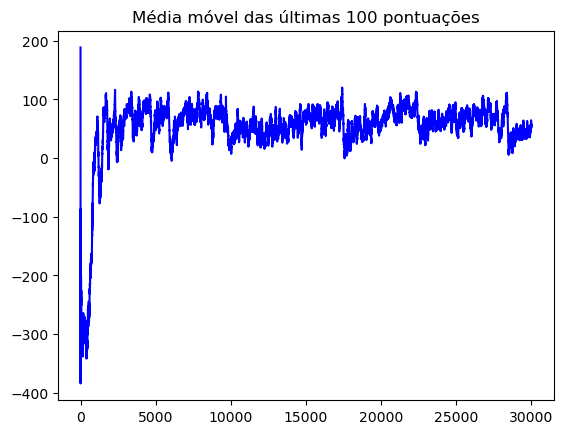

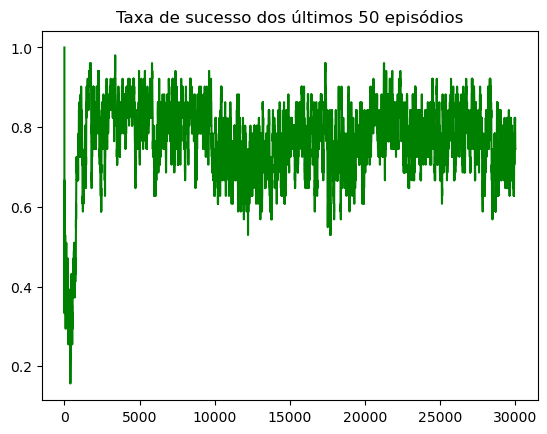

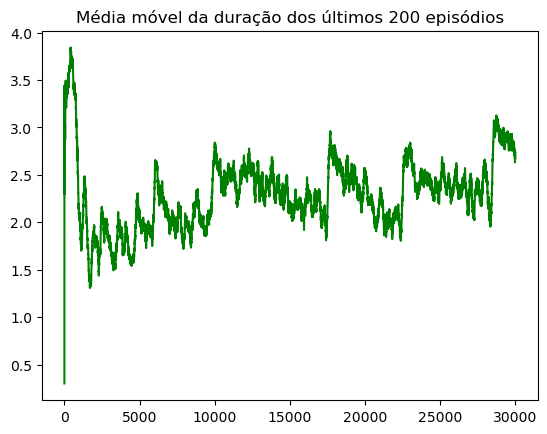

In [5]:
   ### RECOMPENSA DINÂMICA ###

# Hyperparameters
N_GAMES = 30001
MEM_SIZE = 100000
BATCH_SIZE = 32
TARGET_UPDATE = 4
GAMMA = 0.99
TAU = 0.005
LR = 1e-4

steps_taken = 0

if __name__ == '__main__':
    plt.ion()
    env = MujocoEnv2_1()
    state_dim = env.state_dim
    action_dim = env.action_dim
    agent = Agent(state_dim, action_dim)

    load = input("load from model? [y/n]: ")
    
    filename = 'DDQN_mujoco_2.5'
    figure_file_score = 'plots/' + filename + '_score.png'
    figure_file_catchrate = 'plots/' + filename + '_catchrate.png'
    figure_file_steps = 'plots/' + filename + '_steps.png'

    if load == "y":
        agent.main_model = load_model(agent.main_model, MODEL_FILE)
        agent.target_model = load_model(agent.main_model, MODEL_FILE)
        actions = load_actions(MODEL_FILE+'_actions')
        agent.eps = agent.eps_min

    max_score = -10000
    max_game = 0
    scores = []
    start = datetime.datetime.now()

    step_history = []
    score_history = []
    success_history = []
    partial_success_history = []
    next_level_points = []
    observable_games = [i for i in range(0, 30001, 500)]

    for game in range(N_GAMES):
        done = False
        score = 0
        success = 0
        observation = env.reset()
        #print(observation)
        game_actions = [] # actions taken during this game
        episode_start = datetime.datetime.now()

        if game not in observable_games:
            while not done:
                action = agent.choose_action(observation)
                next_observation, reward, done = env.step(action)
                action = torch.tensor(action).long()
                agent.step(observation, action, reward, next_observation, done)
                score += float(reward)
                observation = next_observation
                if game % TARGET_UPDATE == 0: agent.soft_update_target_model(TAU)
                if reward > 0: success = 1
        else:
            while not done:
                action = agent.choose_action(observation)
                next_observation, reward, done = env.rstep(action)
                action = torch.tensor(action).long()
                agent.step(observation, action, reward, next_observation, done)
                score += float(reward)
                observation = next_observation
                if game % TARGET_UPDATE == 0: agent.soft_update_target_model(TAU)
                if reward > 0: success = 1
            media.show_video(env.frames, fps=env.framerate)

        # Update variables each game
        agent.decrement_epsilon()
        episode_end = datetime.datetime.now()
        elapsed = episode_end - episode_start
        scores.append(score)
        avg_score = np.mean(scores[-100:])
        
        step_history.append(env.tfin)
        score_history.append(score)
        success_history.append(success)
        partial_success_history.append(success)

        # Checks if the max score has been beaten
        if score > max_score:
            max_score = score
            max_game = game

            save_model(agent.main_model, MODEL_FILE)
            store_actions(game_actions, MODEL_FILE+'_actions')

        if len(partial_success_history)>600 and np.mean(partial_success_history[-100:])>0.9:
            partial_success_history = []
            env.setNextDistancia()
            max_score = -10000
            agent.eps += 0.2
            next_level_points.append(game)
            print('NEXT LEVEL')

        print("eps:",agent.eps)
        print('game:', game)
        print('reward:', str(score))
        print('average score for the last 100 games:', avg_score)
        print('partial success avg %.2f' %np.mean(partial_success_history[-100:]), ' dist %.2f' %env.dist)
        print('time:', str(elapsed.total_seconds()),'seconds')
        print()

    # After going through N_GAMES
    end = datetime.datetime.now()
    elapsed = end - start

    print('Total time:',elapsed.total_seconds(), 'seconds')
    
    x = [i+1 for i in range(N_GAMES)]
    %matplotlib inline
    plt.figure('learning')
    plot_learning_curve(x, score_history, figure_file_score)
    plt.figure('catching')
    plot_success_curve(x, success_history, figure_file_catchrate)
    plt.figure('steps')
    plot_step_curve(x, step_history, figure_file_steps)

    scores_file = open(MODEL_FILE+'_scores','wb')
    pickle.dump(scores, scores_file)
    scores_file.close()

In [6]:
print(max_game)

29239


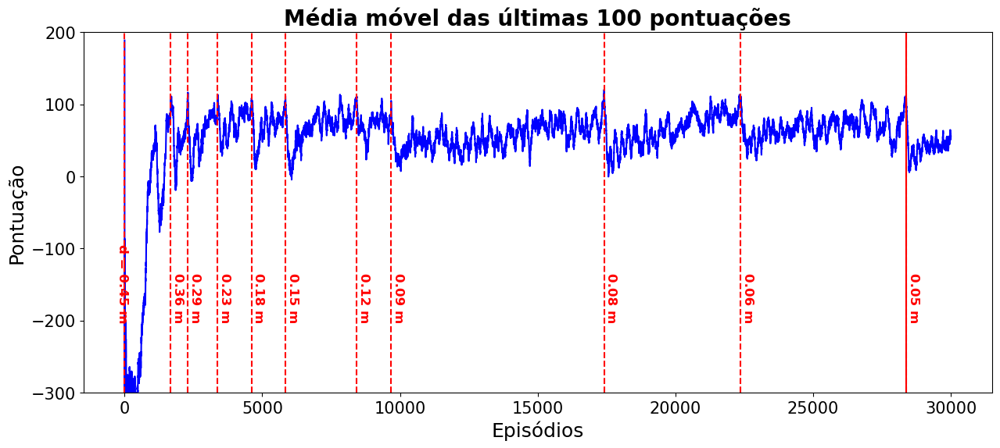

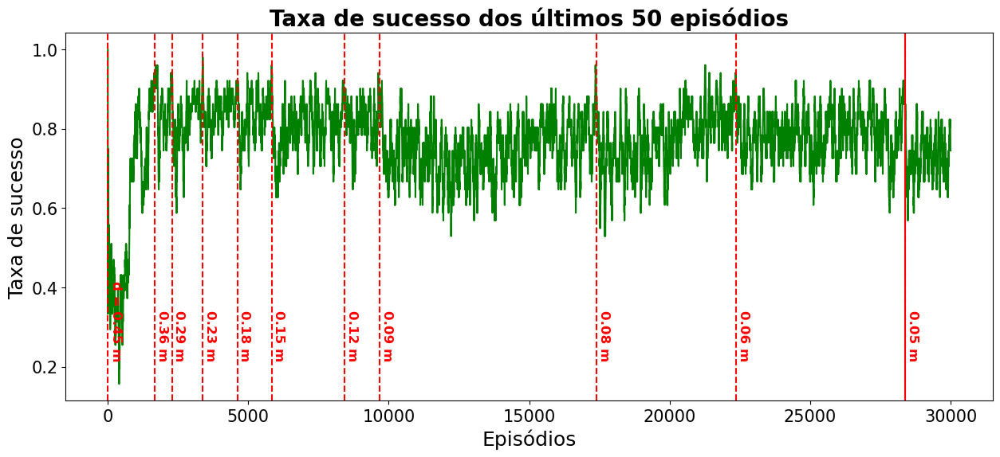

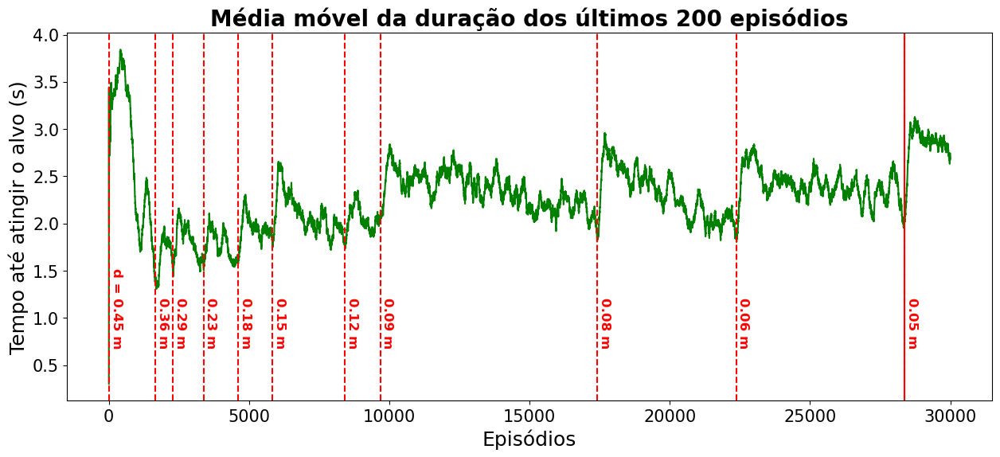

In [22]:
def plot_learning_curve(x, scores, figure_file):
    running_avg_score = np.zeros(len(scores))
    for i in range(len(running_avg_score)):
        running_avg_score[i] = np.mean(scores[max(0, i-100):(i+1)])
    plt.plot(x, running_avg_score, '-b')
    plt.ylim(-300,200)
    plt.xticks(fontsize='15')
    plt.yticks(fontsize='15')
    plt.xlabel('Episódios',fontsize='18')
    plt.ylabel('Pontuação',fontsize='18')
    plt.axvline(x=next_level_points[-1], color='red')
    plt.axvline(0,color='red',linestyle='--')
    plt.text(-300,-200,'d = 0.45 m',rotation=-90,color='red',weight='bold',size='12')
    d = 0.45
    for p in next_level_points[:]:
        d = d*0.8
        plt.text(p+50,-200,'%.2f m'%d,rotation=-90,color='red',weight='bold',size='12')
        plt.axvline(x=p, color='red', linestyle='--')
    plt.title('Média móvel das últimas 100 pontuações',size='20',weight='bold')
    plt.savefig(figure_file)

def plot_success_curve(x, successes, figure_file):
    running_success_rate = np.zeros(len(successes))
    for i in range(len(running_success_rate)):
        running_success_rate[i] = np.mean(successes[max(0, i-50):(i+1)])
    plt.plot(x, running_success_rate, '-g')
    plt.xticks(fontsize='15')
    plt.yticks(fontsize='15')
    plt.xlabel('Episódios',fontsize='18')
    plt.ylabel('Taxa de sucesso',fontsize='18')
    plt.axvline(x=next_level_points[-1], color='red')
    plt.axvline(0,color='red',linestyle='--')
    plt.text(80,0.22,'d = 0.45 m',rotation=-90,color='red',weight='bold',size='12')
    d = 0.45
    for p in next_level_points[:]:
        d = d*0.8
        plt.text(p+50,0.22,'%.2f m'%d,rotation=-90,color='red',weight='bold',size='12')
        plt.axvline(x=p, color='red', linestyle='--')
    plt.title('Taxa de sucesso dos últimos 50 episódios',size='20',weight='bold')
    plt.savefig(figure_file)

def plot_step_curve(x, steps, figure_file):
    running_step_avg = np.zeros(len(steps))
    for i in range(len(running_step_avg)):
        running_step_avg[i] = np.mean(steps[max(0, i-200):(i+1)])
    plt.plot(x, running_step_avg, '-g')
    plt.xticks(fontsize='15')
    plt.yticks(fontsize='15')
    plt.xlabel('Episódios',fontsize='18')
    plt.ylabel('Tempo até atingir o alvo (s)',fontsize='18')
    plt.axvline(x=next_level_points[-1], color='red')
    plt.axvline(0,color='red',linestyle='--')
    plt.text(65,0.7,'d = 0.45 m',rotation=-90,color='red',weight='bold',size='12')
    d = 0.45
    for p in next_level_points[:]:
        d = d*0.8
        plt.text(p+50,0.7,'%.2f m'%d,rotation=-90,color='red',weight='bold',size='12')
        plt.axvline(x=p, color='red', linestyle='--')
    plt.title('Média móvel da duração dos últimos 200 episódios',size='20',weight='bold')
    plt.savefig(figure_file)

x = [i+1 for i in range(30001)]
%matplotlib inline
plt.figure('learning',figsize=(15,6))
plot_learning_curve(x, score_history, figure_file_score)
plt.figure('catching',figsize=(15,6))
plot_success_curve(x, success_history, figure_file_catchrate)
plt.figure('steps',figsize=(15,6))
plot_step_curve(x, step_history, figure_file_steps)

In [24]:
save_model(agent.main_model, MODEL_FILE)
store_actions(game_actions, MODEL_FILE+'_actions')

In [10]:
plt.ion()
env = MujocoEnv2_1()
state_dim = env.state_dim
action_dim = env.action_dim
agent = Agent(state_dim, action_dim)

agent.main_model = load_model(agent.main_model, MODEL_FILE)
agent.target_model = load_model(agent.main_model, MODEL_FILE)
actions = load_actions(MODEL_FILE+'_actions')
agent.eps = agent.eps_min
success_games = []

fixedGames = []
for i in np.arange(1, 1.6, 0.1):
    for j in np.arange(0, 2*np.pi, np.pi/18):
        list = [i, j] 
        fixedGames.append(list)

for game in range(len(fixedGames)):
    env.variaPos(float(fixedGames[game][0]),float(fixedGames[game][1]))
    done = False
    score = 0
    success = 0
    observation = env.resetFixo()
    game_actions = [] # actions taken during this game

    while not done:
        action = agent.choose_action(observation)
        next_observation, reward, done = env.rstep(action)
        action = torch.tensor(action).long()
        #agent.step(observation, action, reward, next_observation, done)
        score += float(reward)
        observation = next_observation
        #if game % TARGET_UPDATE == 0: agent.soft_update_target_model(TAU)
        if reward > 0:
            success = 1

    media.show_video(env.frames, fps=env.framerate)

    print('Jogo:', game, ' \  Raio:', env.radius, ' \  Ângulo:', env.angle*180/np.pi)
    print('Recompensa:', str(score))
    print('-------------------------------------------------')
    if success: success_games.append((env.radius,env.angle))

Jogo: 0  \  Raio: 1.0  \  Ângulo: 0.0
Recompensa: -147.13637069904453
-------------------------------------------------


Jogo: 1  \  Raio: 1.0  \  Ângulo: 10.0
Recompensa: -141.32302374253595
-------------------------------------------------
success


Jogo: 2  \  Raio: 1.0  \  Ângulo: 20.0
Recompensa: 139.37735019317978
-------------------------------------------------
success


Jogo: 3  \  Raio: 1.0  \  Ângulo: 29.999999999999996
Recompensa: 164.96560926542543
-------------------------------------------------
success


Jogo: 4  \  Raio: 1.0  \  Ângulo: 40.0
Recompensa: 127.2321100917273
-------------------------------------------------
success


Jogo: 5  \  Raio: 1.0  \  Ângulo: 50.0
Recompensa: 150.88372150028584
-------------------------------------------------
success


Jogo: 6  \  Raio: 1.0  \  Ângulo: 59.99999999999999
Recompensa: 154.56398552213716
-------------------------------------------------
success


Jogo: 7  \  Raio: 1.0  \  Ângulo: 70.0
Recompensa: 157.0456409611469
-------------------------------------------------
success


Jogo: 8  \  Raio: 1.0  \  Ângulo: 80.0
Recompensa: 151.023803766992
-------------------------------------------------
success


Jogo: 9  \  Raio: 1.0  \  Ângulo: 90.0
Recompensa: 153.09903874660463
-------------------------------------------------
success


Jogo: 10  \  Raio: 1.0  \  Ângulo: 100.0
Recompensa: 154.87073853047946
-------------------------------------------------
success


Jogo: 11  \  Raio: 1.0  \  Ângulo: 110.0
Recompensa: 125.08879726476957
-------------------------------------------------
success


Jogo: 12  \  Raio: 1.0  \  Ângulo: 119.99999999999999
Recompensa: 135.53549605792026
-------------------------------------------------
success


Jogo: 13  \  Raio: 1.0  \  Ângulo: 130.0
Recompensa: 125.25839013191734
-------------------------------------------------
success


Jogo: 14  \  Raio: 1.0  \  Ângulo: 140.0
Recompensa: 141.6862545177353
-------------------------------------------------
success


Jogo: 15  \  Raio: 1.0  \  Ângulo: 150.00000000000003
Recompensa: 131.7549362198212
-------------------------------------------------
success


Jogo: 16  \  Raio: 1.0  \  Ângulo: 160.0
Recompensa: 121.53433709762685
-------------------------------------------------
success


Jogo: 17  \  Raio: 1.0  \  Ângulo: 170.0
Recompensa: 120.23336611740396
-------------------------------------------------
success


Jogo: 18  \  Raio: 1.0  \  Ângulo: 180.0
Recompensa: 106.99558612662936
-------------------------------------------------


Jogo: 19  \  Raio: 1.0  \  Ângulo: 190.0
Recompensa: -189.1097456900391
-------------------------------------------------


Jogo: 20  \  Raio: 1.0  \  Ângulo: 200.0
Recompensa: -177.97717748063175
-------------------------------------------------


Jogo: 21  \  Raio: 1.0  \  Ângulo: 209.99999999999997
Recompensa: -170.3769825624412
-------------------------------------------------


Jogo: 22  \  Raio: 1.0  \  Ângulo: 220.0
Recompensa: -165.52152989402785
-------------------------------------------------
success


Jogo: 23  \  Raio: 1.0  \  Ângulo: 229.99999999999997
Recompensa: 64.91444962386348
-------------------------------------------------


Jogo: 24  \  Raio: 1.0  \  Ângulo: 239.99999999999997
Recompensa: -148.96451741447697
-------------------------------------------------
success


Jogo: 25  \  Raio: 1.0  \  Ângulo: 249.99999999999997
Recompensa: 148.39758513036406
-------------------------------------------------


Jogo: 26  \  Raio: 1.0  \  Ângulo: 260.0
Recompensa: -137.69389939071942
-------------------------------------------------
success


Jogo: 27  \  Raio: 1.0  \  Ângulo: 270.0
Recompensa: 163.03776087304826
-------------------------------------------------
success


Jogo: 28  \  Raio: 1.0  \  Ângulo: 280.0
Recompensa: 156.14013590254407
-------------------------------------------------


Jogo: 29  \  Raio: 1.0  \  Ângulo: 290.0
Recompensa: -131.97192646411864
-------------------------------------------------
success


Jogo: 30  \  Raio: 1.0  \  Ângulo: 300.00000000000006
Recompensa: 170.1000840802065
-------------------------------------------------
success


Jogo: 31  \  Raio: 1.0  \  Ângulo: 310.0
Recompensa: 164.28773285744845
-------------------------------------------------
success


Jogo: 32  \  Raio: 1.0  \  Ângulo: 320.0
Recompensa: 164.7714084794953
-------------------------------------------------


Jogo: 33  \  Raio: 1.0  \  Ângulo: 329.99999999999994
Recompensa: -125.95732777844403
-------------------------------------------------
success


Jogo: 34  \  Raio: 1.0  \  Ângulo: 340.0
Recompensa: 114.15613034001929
-------------------------------------------------


Jogo: 35  \  Raio: 1.0  \  Ângulo: 350.00000000000006
Recompensa: -137.25120598669102
-------------------------------------------------
success


Jogo: 36  \  Raio: 1.1  \  Ângulo: 0.0
Recompensa: 173.37714520027714
-------------------------------------------------


Jogo: 37  \  Raio: 1.1  \  Ângulo: 10.0
Recompensa: -132.00882440419844
-------------------------------------------------
success


Jogo: 38  \  Raio: 1.1  \  Ângulo: 20.0
Recompensa: 157.9244169462422
-------------------------------------------------
success


Jogo: 39  \  Raio: 1.1  \  Ângulo: 29.999999999999996
Recompensa: 168.9087369412515
-------------------------------------------------
success


Jogo: 40  \  Raio: 1.1  \  Ângulo: 40.0
Recompensa: 155.40955337556034
-------------------------------------------------
success


Jogo: 41  \  Raio: 1.1  \  Ângulo: 50.0
Recompensa: 130.04629470867218
-------------------------------------------------
success


Jogo: 42  \  Raio: 1.1  \  Ângulo: 59.99999999999999
Recompensa: 155.36017650711014
-------------------------------------------------
success


Jogo: 43  \  Raio: 1.1  \  Ângulo: 70.0
Recompensa: 149.30996427238884
-------------------------------------------------
success


Jogo: 44  \  Raio: 1.1  \  Ângulo: 80.0
Recompensa: 161.87323370021568
-------------------------------------------------
success


Jogo: 45  \  Raio: 1.1  \  Ângulo: 90.0
Recompensa: 154.30999223311272
-------------------------------------------------


Jogo: 46  \  Raio: 1.1  \  Ângulo: 100.0
Recompensa: -138.07125814922873
-------------------------------------------------
success


Jogo: 47  \  Raio: 1.1  \  Ângulo: 110.0
Recompensa: 134.5185960519679
-------------------------------------------------
success


Jogo: 48  \  Raio: 1.1  \  Ângulo: 119.99999999999999
Recompensa: 125.16912563831758
-------------------------------------------------


Jogo: 49  \  Raio: 1.1  \  Ângulo: 130.0
Recompensa: -156.48394139137355
-------------------------------------------------


Jogo: 50  \  Raio: 1.1  \  Ângulo: 140.0
Recompensa: -161.16442922923997
-------------------------------------------------


Jogo: 51  \  Raio: 1.1  \  Ângulo: 150.00000000000003
Recompensa: -165.102703634294
-------------------------------------------------
success


Jogo: 52  \  Raio: 1.1  \  Ângulo: 160.0
Recompensa: 109.13821724262607
-------------------------------------------------
success


Jogo: 53  \  Raio: 1.1  \  Ângulo: 170.0
Recompensa: 46.741155899854675
-------------------------------------------------


Jogo: 54  \  Raio: 1.1  \  Ângulo: 180.0
Recompensa: -193.41755860099082
-------------------------------------------------


Jogo: 55  \  Raio: 1.1  \  Ângulo: 190.0
Recompensa: -184.37356863772268
-------------------------------------------------


Jogo: 56  \  Raio: 1.1  \  Ângulo: 200.0
Recompensa: -170.86524368998425
-------------------------------------------------
success


Jogo: 57  \  Raio: 1.1  \  Ângulo: 209.99999999999997
Recompensa: 118.8020581307451
-------------------------------------------------


Jogo: 58  \  Raio: 1.1  \  Ângulo: 220.0
Recompensa: -155.46800129632763
-------------------------------------------------


Jogo: 59  \  Raio: 1.1  \  Ângulo: 229.99999999999997
Recompensa: -152.6209880443074
-------------------------------------------------


Jogo: 60  \  Raio: 1.1  \  Ângulo: 239.99999999999997
Recompensa: -143.99752167636746
-------------------------------------------------
success


Jogo: 61  \  Raio: 1.1  \  Ângulo: 249.99999999999997
Recompensa: 153.1034005993654
-------------------------------------------------
success


Jogo: 62  \  Raio: 1.1  \  Ângulo: 260.0
Recompensa: 88.79676831162834
-------------------------------------------------
success


Jogo: 63  \  Raio: 1.1  \  Ângulo: 270.0
Recompensa: 163.87278593023802
-------------------------------------------------
success


Jogo: 64  \  Raio: 1.1  \  Ângulo: 280.0
Recompensa: 166.35084682859983
-------------------------------------------------
success


Jogo: 65  \  Raio: 1.1  \  Ângulo: 290.0
Recompensa: 169.79145732749453
-------------------------------------------------
success


Jogo: 66  \  Raio: 1.1  \  Ângulo: 300.00000000000006
Recompensa: 123.07947112961192
-------------------------------------------------


Jogo: 67  \  Raio: 1.1  \  Ângulo: 310.0
Recompensa: -126.63257977475232
-------------------------------------------------
success


Jogo: 68  \  Raio: 1.1  \  Ângulo: 320.0
Recompensa: 157.19316741567278
-------------------------------------------------
success


Jogo: 69  \  Raio: 1.1  \  Ângulo: 329.99999999999994
Recompensa: 131.4970734121196
-------------------------------------------------
success


Jogo: 70  \  Raio: 1.1  \  Ângulo: 340.0
Recompensa: 150.66959986558658
-------------------------------------------------
success


Jogo: 71  \  Raio: 1.1  \  Ângulo: 350.00000000000006
Recompensa: 106.14901626767319
-------------------------------------------------
success


Jogo: 72  \  Raio: 1.2000000000000002  \  Ângulo: 0.0
Recompensa: 175.5110756128724
-------------------------------------------------
success


Jogo: 73  \  Raio: 1.2000000000000002  \  Ângulo: 10.0
Recompensa: 160.41193915451575
-------------------------------------------------
success


Jogo: 74  \  Raio: 1.2000000000000002  \  Ângulo: 20.0
Recompensa: 174.52509046296697
-------------------------------------------------
success


Jogo: 75  \  Raio: 1.2000000000000002  \  Ângulo: 29.999999999999996
Recompensa: 157.94431888593252
-------------------------------------------------
success


Jogo: 76  \  Raio: 1.2000000000000002  \  Ângulo: 40.0
Recompensa: 171.31212592520805
-------------------------------------------------
success


Jogo: 77  \  Raio: 1.2000000000000002  \  Ângulo: 50.0
Recompensa: 144.98911940897213
-------------------------------------------------
success


Jogo: 78  \  Raio: 1.2000000000000002  \  Ângulo: 59.99999999999999
Recompensa: 147.89979597770338
-------------------------------------------------
success


Jogo: 79  \  Raio: 1.2000000000000002  \  Ângulo: 70.0
Recompensa: 160.27995538081134
-------------------------------------------------
success


Jogo: 80  \  Raio: 1.2000000000000002  \  Ângulo: 80.0
Recompensa: 153.6023757872773
-------------------------------------------------
success


Jogo: 81  \  Raio: 1.2000000000000002  \  Ângulo: 90.0
Recompensa: 159.38281169459336
-------------------------------------------------
success


Jogo: 82  \  Raio: 1.2000000000000002  \  Ângulo: 100.0
Recompensa: 107.7315190275458
-------------------------------------------------
success


Jogo: 83  \  Raio: 1.2000000000000002  \  Ângulo: 110.0
Recompensa: 144.14233548293362
-------------------------------------------------
success


Jogo: 84  \  Raio: 1.2000000000000002  \  Ângulo: 119.99999999999999
Recompensa: 152.8125070974821
-------------------------------------------------
success


Jogo: 85  \  Raio: 1.2000000000000002  \  Ângulo: 130.0
Recompensa: 142.09986019561586
-------------------------------------------------
success


Jogo: 86  \  Raio: 1.2000000000000002  \  Ângulo: 140.0
Recompensa: 118.88934620235032
-------------------------------------------------
success


Jogo: 87  \  Raio: 1.2000000000000002  \  Ângulo: 150.00000000000003
Recompensa: 115.99505389813369
-------------------------------------------------
success


Jogo: 88  \  Raio: 1.2000000000000002  \  Ângulo: 160.0
Recompensa: 103.4035909293339
-------------------------------------------------
success


Jogo: 89  \  Raio: 1.2000000000000002  \  Ângulo: 170.0
Recompensa: 80.87097770735438
-------------------------------------------------


Jogo: 90  \  Raio: 1.2000000000000002  \  Ângulo: 180.0
Recompensa: -197.99663640064747
-------------------------------------------------


Jogo: 91  \  Raio: 1.2000000000000002  \  Ângulo: 190.0
Recompensa: -182.3779693524569
-------------------------------------------------
success


Jogo: 92  \  Raio: 1.2000000000000002  \  Ângulo: 200.0
Recompensa: 108.91011795903943
-------------------------------------------------
success


Jogo: 93  \  Raio: 1.2000000000000002  \  Ângulo: 209.99999999999997
Recompensa: 121.0790440048002
-------------------------------------------------


Jogo: 94  \  Raio: 1.2000000000000002  \  Ângulo: 220.0
Recompensa: -156.5376075891666
-------------------------------------------------
success


Jogo: 95  \  Raio: 1.2000000000000002  \  Ângulo: 229.99999999999997
Recompensa: 136.59952353762182
-------------------------------------------------
success


Jogo: 96  \  Raio: 1.2000000000000002  \  Ângulo: 239.99999999999997
Recompensa: 136.7558664379987
-------------------------------------------------
success


Jogo: 97  \  Raio: 1.2000000000000002  \  Ângulo: 249.99999999999997
Recompensa: 148.08891535876046
-------------------------------------------------
success


Jogo: 98  \  Raio: 1.2000000000000002  \  Ângulo: 260.0
Recompensa: 134.0008875399758
-------------------------------------------------
success


Jogo: 99  \  Raio: 1.2000000000000002  \  Ângulo: 270.0
Recompensa: 164.2163737509189
-------------------------------------------------
success


Jogo: 100  \  Raio: 1.2000000000000002  \  Ângulo: 280.0
Recompensa: 166.87282118516873
-------------------------------------------------
success


Jogo: 101  \  Raio: 1.2000000000000002  \  Ângulo: 290.0
Recompensa: 170.79589785350956
-------------------------------------------------
success


Jogo: 102  \  Raio: 1.2000000000000002  \  Ângulo: 300.00000000000006
Recompensa: 145.97617167832937
-------------------------------------------------
success


Jogo: 103  \  Raio: 1.2000000000000002  \  Ângulo: 310.0
Recompensa: 163.3396055025093
-------------------------------------------------
success


Jogo: 104  \  Raio: 1.2000000000000002  \  Ângulo: 320.0
Recompensa: 168.66131859493026
-------------------------------------------------
success


Jogo: 105  \  Raio: 1.2000000000000002  \  Ângulo: 329.99999999999994
Recompensa: 169.07351970836896
-------------------------------------------------
success


Jogo: 106  \  Raio: 1.2000000000000002  \  Ângulo: 340.0
Recompensa: 145.019671059004
-------------------------------------------------
success


Jogo: 107  \  Raio: 1.2000000000000002  \  Ângulo: 350.00000000000006
Recompensa: 142.46826823599872
-------------------------------------------------
success


Jogo: 108  \  Raio: 1.3000000000000003  \  Ângulo: 0.0
Recompensa: 167.40891514763243
-------------------------------------------------
success


Jogo: 109  \  Raio: 1.3000000000000003  \  Ângulo: 10.0
Recompensa: 110.07774521864376
-------------------------------------------------
success


Jogo: 110  \  Raio: 1.3000000000000003  \  Ângulo: 20.0
Recompensa: 87.1527542199504
-------------------------------------------------
success


Jogo: 111  \  Raio: 1.3000000000000003  \  Ângulo: 29.999999999999996
Recompensa: 169.712459074586
-------------------------------------------------
success


Jogo: 112  \  Raio: 1.3000000000000003  \  Ângulo: 40.0
Recompensa: 173.45261186818271
-------------------------------------------------
success


Jogo: 113  \  Raio: 1.3000000000000003  \  Ângulo: 50.0
Recompensa: 156.03542189735077
-------------------------------------------------
success


Jogo: 114  \  Raio: 1.3000000000000003  \  Ângulo: 59.99999999999999
Recompensa: 158.99444460958367
-------------------------------------------------
success


Jogo: 115  \  Raio: 1.3000000000000003  \  Ângulo: 70.0
Recompensa: 159.98592912172217
-------------------------------------------------
success


Jogo: 116  \  Raio: 1.3000000000000003  \  Ângulo: 80.0
Recompensa: 163.72710142549073
-------------------------------------------------
success


Jogo: 117  \  Raio: 1.3000000000000003  \  Ângulo: 90.0
Recompensa: 154.8814791299651
-------------------------------------------------
success


Jogo: 118  \  Raio: 1.3000000000000003  \  Ângulo: 100.0
Recompensa: 162.7881718867357
-------------------------------------------------
success


Jogo: 119  \  Raio: 1.3000000000000003  \  Ângulo: 110.0
Recompensa: 142.8864900657721
-------------------------------------------------
success


Jogo: 120  \  Raio: 1.3000000000000003  \  Ângulo: 119.99999999999999
Recompensa: 151.1655852384364
-------------------------------------------------
success


Jogo: 121  \  Raio: 1.3000000000000003  \  Ângulo: 130.0
Recompensa: 119.24790750461037
-------------------------------------------------


Jogo: 122  \  Raio: 1.3000000000000003  \  Ângulo: 140.0
Recompensa: -168.71031318217325
-------------------------------------------------
success


Jogo: 123  \  Raio: 1.3000000000000003  \  Ângulo: 150.00000000000003
Recompensa: 121.61482116971578
-------------------------------------------------


Jogo: 124  \  Raio: 1.3000000000000003  \  Ângulo: 160.0
Recompensa: -192.9170171186428
-------------------------------------------------
success


Jogo: 125  \  Raio: 1.3000000000000003  \  Ângulo: 170.0
Recompensa: 54.02184923609295
-------------------------------------------------


Jogo: 126  \  Raio: 1.3000000000000003  \  Ângulo: 180.0
Recompensa: -201.3956974676346
-------------------------------------------------
success


Jogo: 127  \  Raio: 1.3000000000000003  \  Ângulo: 190.0
Recompensa: 31.881804497267268
-------------------------------------------------


Jogo: 128  \  Raio: 1.3000000000000003  \  Ângulo: 200.0
Recompensa: -176.5845557789945
-------------------------------------------------


Jogo: 129  \  Raio: 1.3000000000000003  \  Ângulo: 209.99999999999997
Recompensa: -167.93617891818246
-------------------------------------------------
success


Jogo: 130  \  Raio: 1.3000000000000003  \  Ângulo: 220.0
Recompensa: 131.11271113922066
-------------------------------------------------
success


Jogo: 131  \  Raio: 1.3000000000000003  \  Ângulo: 229.99999999999997
Recompensa: 130.23262326333423
-------------------------------------------------
success


Jogo: 132  \  Raio: 1.3000000000000003  \  Ângulo: 239.99999999999997
Recompensa: 106.07898160844692
-------------------------------------------------
success


Jogo: 133  \  Raio: 1.3000000000000003  \  Ângulo: 249.99999999999997
Recompensa: 147.19263869484578
-------------------------------------------------
success


Jogo: 134  \  Raio: 1.3000000000000003  \  Ângulo: 260.0
Recompensa: 151.0931966632241
-------------------------------------------------


Jogo: 135  \  Raio: 1.3000000000000003  \  Ângulo: 270.0
Recompensa: -134.26592273985875
-------------------------------------------------
success


Jogo: 136  \  Raio: 1.3000000000000003  \  Ângulo: 280.0
Recompensa: 162.71837278909214
-------------------------------------------------
success


Jogo: 137  \  Raio: 1.3000000000000003  \  Ângulo: 290.0
Recompensa: 145.04339943523115
-------------------------------------------------


Jogo: 138  \  Raio: 1.3000000000000003  \  Ângulo: 300.00000000000006
Recompensa: -117.48065650109906
-------------------------------------------------
success


Jogo: 139  \  Raio: 1.3000000000000003  \  Ângulo: 310.0
Recompensa: 169.3709743948869
-------------------------------------------------
success


Jogo: 140  \  Raio: 1.3000000000000003  \  Ângulo: 320.0
Recompensa: 179.32623852495064
-------------------------------------------------
success


Jogo: 141  \  Raio: 1.3000000000000003  \  Ângulo: 329.99999999999994
Recompensa: 179.83322048838687
-------------------------------------------------
success


Jogo: 142  \  Raio: 1.3000000000000003  \  Ângulo: 340.0
Recompensa: 166.02298579089148
-------------------------------------------------
success


Jogo: 143  \  Raio: 1.3000000000000003  \  Ângulo: 350.00000000000006
Recompensa: 116.37744308368504
-------------------------------------------------


Jogo: 144  \  Raio: 1.4000000000000004  \  Ângulo: 0.0
Recompensa: -121.38789908187104
-------------------------------------------------
success


Jogo: 145  \  Raio: 1.4000000000000004  \  Ângulo: 10.0
Recompensa: 153.36999661339618
-------------------------------------------------
success


Jogo: 146  \  Raio: 1.4000000000000004  \  Ângulo: 20.0
Recompensa: 136.68751292542348
-------------------------------------------------
success


Jogo: 147  \  Raio: 1.4000000000000004  \  Ângulo: 29.999999999999996
Recompensa: 171.31459779118256
-------------------------------------------------
success


Jogo: 148  \  Raio: 1.4000000000000004  \  Ângulo: 40.0
Recompensa: 173.98298831546055
-------------------------------------------------
success


Jogo: 149  \  Raio: 1.4000000000000004  \  Ângulo: 50.0
Recompensa: 167.78871964664347
-------------------------------------------------
success


Jogo: 150  \  Raio: 1.4000000000000004  \  Ângulo: 59.99999999999999
Recompensa: 144.38701599568327
-------------------------------------------------


Jogo: 151  \  Raio: 1.4000000000000004  \  Ângulo: 70.0
Recompensa: -134.35033627561123
-------------------------------------------------


Jogo: 152  \  Raio: 1.4000000000000004  \  Ângulo: 80.0
Recompensa: -132.9962573723931
-------------------------------------------------


Jogo: 153  \  Raio: 1.4000000000000004  \  Ângulo: 90.0
Recompensa: -136.81474246908834
-------------------------------------------------


Jogo: 154  \  Raio: 1.4000000000000004  \  Ângulo: 100.0
Recompensa: -141.56747535068615
-------------------------------------------------
success


Jogo: 155  \  Raio: 1.4000000000000004  \  Ângulo: 110.0
Recompensa: 140.24657666053196
-------------------------------------------------
success


Jogo: 156  \  Raio: 1.4000000000000004  \  Ângulo: 119.99999999999999
Recompensa: 138.65374164728587
-------------------------------------------------
success


Jogo: 157  \  Raio: 1.4000000000000004  \  Ângulo: 130.0
Recompensa: 115.05869104004944
-------------------------------------------------


Jogo: 158  \  Raio: 1.4000000000000004  \  Ângulo: 140.0
Recompensa: -178.04597860249896
-------------------------------------------------
success


Jogo: 159  \  Raio: 1.4000000000000004  \  Ângulo: 150.00000000000003
Recompensa: 112.56140304343837
-------------------------------------------------


Jogo: 160  \  Raio: 1.4000000000000004  \  Ângulo: 160.0
Recompensa: -202.6798772224127
-------------------------------------------------


Jogo: 161  \  Raio: 1.4000000000000004  \  Ângulo: 170.0
Recompensa: -205.8440909104169
-------------------------------------------------


Jogo: 162  \  Raio: 1.4000000000000004  \  Ângulo: 180.0
Recompensa: -204.6076779723208
-------------------------------------------------


Jogo: 163  \  Raio: 1.4000000000000004  \  Ângulo: 190.0
Recompensa: -185.09753351111908
-------------------------------------------------
success


Jogo: 164  \  Raio: 1.4000000000000004  \  Ângulo: 200.0
Recompensa: 107.87149254549784
-------------------------------------------------


Jogo: 165  \  Raio: 1.4000000000000004  \  Ângulo: 209.99999999999997
Recompensa: -175.05311788408935
-------------------------------------------------


Jogo: 166  \  Raio: 1.4000000000000004  \  Ângulo: 220.0
Recompensa: -161.41999377012115
-------------------------------------------------


Jogo: 167  \  Raio: 1.4000000000000004  \  Ângulo: 229.99999999999997
Recompensa: -157.78748896957146
-------------------------------------------------
success


Jogo: 168  \  Raio: 1.4000000000000004  \  Ângulo: 239.99999999999997
Recompensa: 145.4798635775054
-------------------------------------------------
success


Jogo: 169  \  Raio: 1.4000000000000004  \  Ângulo: 249.99999999999997
Recompensa: 150.8150548542634
-------------------------------------------------


Jogo: 170  \  Raio: 1.4000000000000004  \  Ângulo: 260.0
Recompensa: -143.81033282172243
-------------------------------------------------
success


Jogo: 171  \  Raio: 1.4000000000000004  \  Ângulo: 270.0
Recompensa: 154.0584685851961
-------------------------------------------------


Jogo: 172  \  Raio: 1.4000000000000004  \  Ângulo: 280.0
Recompensa: -129.82852773191743
-------------------------------------------------


Jogo: 173  \  Raio: 1.4000000000000004  \  Ângulo: 290.0
Recompensa: -124.17434727353591
-------------------------------------------------


Jogo: 174  \  Raio: 1.4000000000000004  \  Ângulo: 300.00000000000006
Recompensa: -118.52190425964439
-------------------------------------------------
success


Jogo: 175  \  Raio: 1.4000000000000004  \  Ângulo: 310.0
Recompensa: 179.24751532599782
-------------------------------------------------
success


Jogo: 176  \  Raio: 1.4000000000000004  \  Ângulo: 320.0
Recompensa: 180.62858431532112
-------------------------------------------------
success


Jogo: 177  \  Raio: 1.4000000000000004  \  Ângulo: 329.99999999999994
Recompensa: 176.45494168532477
-------------------------------------------------


Jogo: 178  \  Raio: 1.4000000000000004  \  Ângulo: 340.0
Recompensa: -119.36901680661174
-------------------------------------------------
success


Jogo: 179  \  Raio: 1.4000000000000004  \  Ângulo: 350.00000000000006
Recompensa: 100.21725579713593
-------------------------------------------------
success


Jogo: 180  \  Raio: 1.5000000000000004  \  Ângulo: 0.0
Recompensa: 184.4665395525654
-------------------------------------------------
success


Jogo: 181  \  Raio: 1.5000000000000004  \  Ângulo: 10.0
Recompensa: 178.88620879588154
-------------------------------------------------
success


Jogo: 182  \  Raio: 1.5000000000000004  \  Ângulo: 20.0
Recompensa: 118.45731319112168
-------------------------------------------------
success


Jogo: 183  \  Raio: 1.5000000000000004  \  Ângulo: 29.999999999999996
Recompensa: 161.9516140755319
-------------------------------------------------
success


Jogo: 184  \  Raio: 1.5000000000000004  \  Ângulo: 40.0
Recompensa: 170.74356251954615
-------------------------------------------------
success


Jogo: 185  \  Raio: 1.5000000000000004  \  Ângulo: 50.0
Recompensa: 179.23333788488364
-------------------------------------------------
success


Jogo: 186  \  Raio: 1.5000000000000004  \  Ângulo: 59.99999999999999
Recompensa: 122.07624164005138
-------------------------------------------------
success


Jogo: 187  \  Raio: 1.5000000000000004  \  Ângulo: 70.0
Recompensa: 170.6949442508609
-------------------------------------------------
success


Jogo: 188  \  Raio: 1.5000000000000004  \  Ângulo: 80.0
Recompensa: 162.90813266837114
-------------------------------------------------
success


Jogo: 189  \  Raio: 1.5000000000000004  \  Ângulo: 90.0
Recompensa: 153.3210188466562
-------------------------------------------------


Jogo: 190  \  Raio: 1.5000000000000004  \  Ângulo: 100.0
Recompensa: -146.19440552521928
-------------------------------------------------
success


Jogo: 191  \  Raio: 1.5000000000000004  \  Ângulo: 110.0
Recompensa: 148.64323058661492
-------------------------------------------------
success


Jogo: 192  \  Raio: 1.5000000000000004  \  Ângulo: 119.99999999999999
Recompensa: 136.9401336157391
-------------------------------------------------


Jogo: 193  \  Raio: 1.5000000000000004  \  Ângulo: 130.0
Recompensa: -175.94131543463118
-------------------------------------------------


Jogo: 194  \  Raio: 1.5000000000000004  \  Ângulo: 140.0
Recompensa: -183.3219211599441
-------------------------------------------------


Jogo: 195  \  Raio: 1.5000000000000004  \  Ângulo: 150.00000000000003
Recompensa: -198.69218134831283
-------------------------------------------------


Jogo: 196  \  Raio: 1.5000000000000004  \  Ângulo: 160.0
Recompensa: -216.99299860521174
-------------------------------------------------


Jogo: 197  \  Raio: 1.5000000000000004  \  Ângulo: 170.0
Recompensa: -206.37318540171145
-------------------------------------------------
success


Jogo: 198  \  Raio: 1.5000000000000004  \  Ângulo: 180.0
Recompensa: 75.70051361768779
-------------------------------------------------


Jogo: 199  \  Raio: 1.5000000000000004  \  Ângulo: 190.0
Recompensa: -195.47668133603332
-------------------------------------------------
success


Jogo: 200  \  Raio: 1.5000000000000004  \  Ângulo: 200.0
Recompensa: 107.79284016770293
-------------------------------------------------


Jogo: 201  \  Raio: 1.5000000000000004  \  Ângulo: 209.99999999999997
Recompensa: -180.04117274595689
-------------------------------------------------
success


Jogo: 202  \  Raio: 1.5000000000000004  \  Ângulo: 220.0
Recompensa: 98.09128137654889
-------------------------------------------------
success


Jogo: 203  \  Raio: 1.5000000000000004  \  Ângulo: 229.99999999999997
Recompensa: 126.19544749700918
-------------------------------------------------
success


Jogo: 204  \  Raio: 1.5000000000000004  \  Ângulo: 239.99999999999997
Recompensa: 139.338315821575
-------------------------------------------------
success


Jogo: 205  \  Raio: 1.5000000000000004  \  Ângulo: 249.99999999999997
Recompensa: 130.15725824979583
-------------------------------------------------


Jogo: 206  \  Raio: 1.5000000000000004  \  Ângulo: 260.0
Recompensa: -144.66884039270613
-------------------------------------------------


Jogo: 207  \  Raio: 1.5000000000000004  \  Ângulo: 270.0
Recompensa: -139.32890751875655
-------------------------------------------------


Jogo: 208  \  Raio: 1.5000000000000004  \  Ângulo: 280.0
Recompensa: -132.41739695828247
-------------------------------------------------
success


Jogo: 209  \  Raio: 1.5000000000000004  \  Ângulo: 290.0
Recompensa: 176.62705962516463
-------------------------------------------------
success


Jogo: 210  \  Raio: 1.5000000000000004  \  Ângulo: 300.00000000000006
Recompensa: 97.09251041790282
-------------------------------------------------
success


Jogo: 211  \  Raio: 1.5000000000000004  \  Ângulo: 310.0
Recompensa: 174.2437745321842
-------------------------------------------------
success


Jogo: 212  \  Raio: 1.5000000000000004  \  Ângulo: 320.0
Recompensa: 180.58222495824918
-------------------------------------------------
success


Jogo: 213  \  Raio: 1.5000000000000004  \  Ângulo: 329.99999999999994
Recompensa: 182.40568952122362
-------------------------------------------------
success


Jogo: 214  \  Raio: 1.5000000000000004  \  Ângulo: 340.0
Recompensa: 155.7656342261972
-------------------------------------------------
success


Jogo: 215  \  Raio: 1.5000000000000004  \  Ângulo: 350.00000000000006
Recompensa: 166.94284644294396
-------------------------------------------------
success


Jogo: 216  \  Raio: 1.6000000000000005  \  Ângulo: 0.0
Recompensa: 175.66389614802114
-------------------------------------------------
success


Jogo: 217  \  Raio: 1.6000000000000005  \  Ângulo: 10.0
Recompensa: 169.60691349307615
-------------------------------------------------


Jogo: 218  \  Raio: 1.6000000000000005  \  Ângulo: 20.0
Recompensa: -119.189702004327
-------------------------------------------------


Jogo: 219  \  Raio: 1.6000000000000005  \  Ângulo: 29.999999999999996
Recompensa: -119.11873538367901
-------------------------------------------------
success


Jogo: 220  \  Raio: 1.6000000000000005  \  Ângulo: 40.0
Recompensa: 177.2680460442778
-------------------------------------------------
success


Jogo: 221  \  Raio: 1.6000000000000005  \  Ângulo: 50.0
Recompensa: 162.48593670948236
-------------------------------------------------
success


Jogo: 222  \  Raio: 1.6000000000000005  \  Ângulo: 59.99999999999999
Recompensa: 160.19199062965262
-------------------------------------------------
success


Jogo: 223  \  Raio: 1.6000000000000005  \  Ângulo: 70.0
Recompensa: 160.86182777453854
-------------------------------------------------
success


Jogo: 224  \  Raio: 1.6000000000000005  \  Ângulo: 80.0
Recompensa: 172.55563099128256
-------------------------------------------------
success


Jogo: 225  \  Raio: 1.6000000000000005  \  Ângulo: 90.0
Recompensa: 113.20900062889012
-------------------------------------------------
success


Jogo: 226  \  Raio: 1.6000000000000005  \  Ângulo: 100.0
Recompensa: 149.35110766085958
-------------------------------------------------
success


Jogo: 227  \  Raio: 1.6000000000000005  \  Ângulo: 110.0
Recompensa: 147.6548619551706
-------------------------------------------------
success


Jogo: 228  \  Raio: 1.6000000000000005  \  Ângulo: 119.99999999999999
Recompensa: 124.58744122574099
-------------------------------------------------


Jogo: 229  \  Raio: 1.6000000000000005  \  Ângulo: 130.0
Recompensa: -176.05438435047776
-------------------------------------------------


Jogo: 230  \  Raio: 1.6000000000000005  \  Ângulo: 140.0
Recompensa: -191.82569910775717
-------------------------------------------------
success


Jogo: 231  \  Raio: 1.6000000000000005  \  Ângulo: 150.00000000000003
Recompensa: 106.1184937383331
-------------------------------------------------
success


Jogo: 232  \  Raio: 1.6000000000000005  \  Ângulo: 160.0
Recompensa: 58.02668235351257
-------------------------------------------------


Jogo: 233  \  Raio: 1.6000000000000005  \  Ângulo: 170.0
Recompensa: -208.07836888466912
-------------------------------------------------
success


Jogo: 234  \  Raio: 1.6000000000000005  \  Ângulo: 180.0
Recompensa: 32.374421733175666
-------------------------------------------------


Jogo: 235  \  Raio: 1.6000000000000005  \  Ângulo: 190.0
Recompensa: -204.2688070038246
-------------------------------------------------
success


Jogo: 236  \  Raio: 1.6000000000000005  \  Ângulo: 200.0
Recompensa: 86.9299872363518
-------------------------------------------------
success


Jogo: 237  \  Raio: 1.6000000000000005  \  Ângulo: 209.99999999999997
Recompensa: 98.996642047997
-------------------------------------------------
success


Jogo: 238  \  Raio: 1.6000000000000005  \  Ângulo: 220.0
Recompensa: 85.7574828216049
-------------------------------------------------


Jogo: 239  \  Raio: 1.6000000000000005  \  Ângulo: 229.99999999999997
Recompensa: -163.892597456652
-------------------------------------------------
success


Jogo: 240  \  Raio: 1.6000000000000005  \  Ângulo: 239.99999999999997
Recompensa: 142.08799217494803
-------------------------------------------------
success


Jogo: 241  \  Raio: 1.6000000000000005  \  Ângulo: 249.99999999999997
Recompensa: 137.93980455781616
-------------------------------------------------


Jogo: 242  \  Raio: 1.6000000000000005  \  Ângulo: 260.0
Recompensa: -145.99594209683372
-------------------------------------------------


Jogo: 243  \  Raio: 1.6000000000000005  \  Ângulo: 270.0
Recompensa: -142.55587842925885
-------------------------------------------------


Jogo: 244  \  Raio: 1.6000000000000005  \  Ângulo: 280.0
Recompensa: -132.45020043349933
-------------------------------------------------


Jogo: 245  \  Raio: 1.6000000000000005  \  Ângulo: 290.0
Recompensa: -128.48195327798842
-------------------------------------------------


Jogo: 246  \  Raio: 1.6000000000000005  \  Ângulo: 300.00000000000006
Recompensa: -125.33390541016746
-------------------------------------------------
success


Jogo: 247  \  Raio: 1.6000000000000005  \  Ângulo: 310.0
Recompensa: 117.45646827633198
-------------------------------------------------
success


Jogo: 248  \  Raio: 1.6000000000000005  \  Ângulo: 320.0
Recompensa: 180.87202276291026
-------------------------------------------------
success


Jogo: 249  \  Raio: 1.6000000000000005  \  Ângulo: 329.99999999999994
Recompensa: 181.38441395984304
-------------------------------------------------


Jogo: 250  \  Raio: 1.6000000000000005  \  Ângulo: 340.0
Recompensa: -112.75894068074027
-------------------------------------------------
success


Jogo: 251  \  Raio: 1.6000000000000005  \  Ângulo: 350.00000000000006
Recompensa: 181.32843107897583
-------------------------------------------------


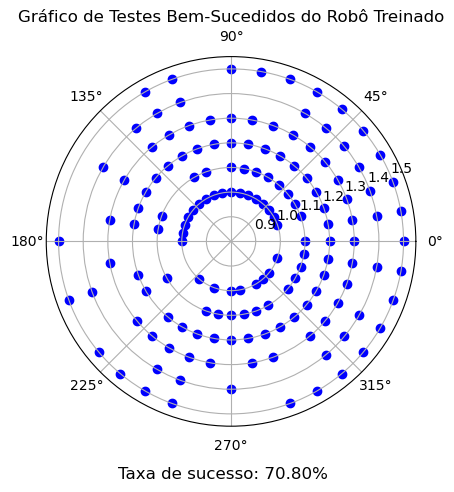

In [13]:
import matplotlib.pyplot as plt

radius, angles = zip(*success_games)

plt.figure()
ax = plt.subplot(111, projection='polar')

scatter = ax.scatter(angles, radius, color='blue')

ax.set_ylim(0.8, 1.55)

ax.set_xticks([0, np.pi/4, np.pi/2, 3*np.pi/4, np.pi, 5*np.pi/4, 3*np.pi/2, 7*np.pi/4])
ax.set_xticklabels(['0°', '45°', '90°', '135°', '180°', '225°', '270°', '315°'])

percentage = len(success_games) / 250 * 100
percentage_formatted = f"{percentage:.2f}%"

plt.figtext(0.5, 0, f'Taxa de sucesso: {percentage_formatted}', ha='center', fontsize=12)

plt.title('Gráfico de Testes Bem-Sucedidos do Robô Treinado')
plt.show()
